In [1]:
import os, sys, json
module_path = os.path.abspath(os.path.join('..'))
sys.path.append(module_path)

import numpy as np
import scipy.stats
import matplotlib.pyplot as plt
from collections import defaultdict
from tabulate import tabulate
from IPython.core.display import display, HTML

# Increase display width
display(HTML("<style>.container { width:80% !important; }</style>"))

# Some styling
# plt.style.use('paper-style')
%matplotlib inline
plt.rcParams['axes.axisbelow'] = True
plt.rcParams['figure.figsize'] = 10, 10
%matplotlib inline

In [3]:
from tqdm import tqdm_notebook
from collections import defaultdict
from data import *
from models.model_utils import preprocess, compute_divergences
import matplotlib.pyplot as plt
from itertools import product
from utils import nested_pickle_dict

gen = Distribution(dist_type='normal', dim=128)
all_results = nested_pickle_dict()

for dist in tqdm_notebook(['normal', 'beta', 'gumbel', 'laplace', 'exponential', 'gamma']):
    
    gen = Distribution(dist_type=dist, dim=128)
    
    for j in range(20):
        
        data = gen.generate_samples(1024)
        data2 = gen.generate_samples(1024)
        results = compute_divergences(np.array(data), data2)
        
        for i in results.keys():
            if i not in all_results2[dist]:
                all_results2[dist][i] = []
            all_results2[dist][i].append(results[i])

for j in ['KL-Divergence', 'Jensen-Shannon', 'Wasserstein-Distance']:
    for dist in ['normal', 'beta', 'gumbel', 'laplace', 'exponential', 'gamma']:
        print(dist, j, np.mean(all_results2[dist][j]))
        all_results2[dist][j] = np.mean(all_results2[dist][j])
    print('\n')


normal KL-Divergence 0.17930718934519269
beta KL-Divergence 0.004984019790312519
gumbel KL-Divergence 0.23485911368637824
laplace KL-Divergence 0.7775518805242312
exponential KL-Divergence 0.17464497345863844
gamma KL-Divergence 0.09619988495506407


normal Jensen-Shannon 0.031088287815890524
beta Jensen-Shannon 0.0012199144413598685
gumbel Jensen-Shannon 0.0379179667352494
laplace Jensen-Shannon 0.12358186530594659
exponential Jensen-Shannon 0.024094519068963725
gamma Jensen-Shannon 0.018767043229943742


normal Wasserstein-Distance 2.414158636555129
beta Wasserstein-Distance 6.793915222362017
gumbel Wasserstein-Distance 15.801381890710493
laplace Wasserstein-Distance 6.951915963689203
exponential Wasserstein-Distance 15.143283482112272
gamma Wasserstein-Distance 7.8967139986552795




In [58]:
##### We reuse these over and over and it's easier to have them in a list than unordered dict
model_names = ["wgan", "wgpgan", "nsgan", "mmgan", "ragan", 
               "lsgan", "dragan", "began", "infogan", "fishergan", 
               "fgan_forward_kl", "fgan_reverse_kl", "fgan_jensen_shannon",
               "fgan_total_var", "fgan_hellinger", "fgan_pearson"]
plot_names = ['WGAN', 'WGANGP', 'NSGAN', 'MMGAN', 'RAGAN', 'LSGAN', 'DRAGAN', 'BEGAN', 'InfoGAN',
              'FisherGAN','ForwGAN', 'RevGAN', 'JSGAN', 'TVGAN', 'HellingerGAN', 'PearsonGAN', 'Expected']
distance_metrics=["KL-Divergence", "Jensen-Shannon", "Wasserstein-Distance"]#, "Energy-Distance"]
title_names=["Kullback-Leibler Divergence", "Jensen-Shannon Divergence", "Wasserstein Distance"]
distributions=['normal', 'beta', 'gumbel', 'laplace', 'exponential', 'gamma']

# Colors
palette = ["#1f77b4", "#aec7e8", "#ff7f0e", "#ffbb78", "#2ca02c", "#98df8a", "#d62728", "#ff9896", "#9467bd",
            "#c5b0d5", "#8c564b", "#c49c94", "#e377c2", "#f7b6d2", "#7f7f7f", "#c7c7c7", "#bcbd22" "#dbdb8d",
            "#17becf", "#9edae5"]

# For subplotting
plt_idx = [(0, 0), (0, 1), (0, 2), (1, 0), (1, 1), (1, 2)]

    
def graph_multivariate(optimal, 
                       ci=True,
                       omit_outliers=True,
                       thresh=8.5,
                       save=False,
                       dims='',
                       samples='',
                       plt_idx=plt_idx,
                       model_names=model_names,
                       distance_metrics=distance_metrics,
                       distributions=distributions,
                       palette=palette):
    
    for m_idx, metric in enumerate(distance_metrics):

        fig, axes = plt.subplots(2, 3, sharex=True, sharey=False, figsize=(20,20))

        for d_idx, distribution in enumerate(distributions):
            
            max_upper = 0

            for idx, model_name in enumerate(model_names):

                if model_name in ['vae', 'autoencoder']:
                    continue
                    
                data = optimal[model_name][distribution][metric]['mean']
                
                if omit_outliers:
                    # Remove outliers
                    orig_data = np.array(data)
                    notnan_indexes = ~np.isnan(orig_data)
                    outlier_indexes = is_outlier(orig_data[notnan_indexes], thresh=thresh)
                    data = orig_data.flatten()[~outlier_indexes]
                    
                    x = np.linspace(0, orig_data.shape[0], data.shape[0])
                    high = data + np.array(optimal[model_name][distribution][metric]['h']).flatten()[~outlier_indexes]
                    low = data - np.array(optimal[model_name][distribution][metric]['h']).flatten()[~outlier_indexes]

                else:
                    
                    x = range(0, len(data))
                    high = data + np.array(optimal[model_name][distribution][metric]['h'])
                    low = data - np.array(optimal[model_name][distribution][metric]['h'])
                    
                axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].plot(x,
                                                                data,
                                                                label=plot_names[idx],
                                                                c=palette[idx])
                maxi = max(data) + (0.10*max(data))
                if maxi > max_upper:
                    max_upper = maxi
                
                if ci == True:
                    axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].fill_between(x,
                                                                            high,
                                                                            [max(0, i) for i in low],
                                                                            facecolor=palette[idx],
                                                                            alpha=0.09)
                
            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].plot(x, [all_results[distribution][metric]]*len(x), 
                                                            'k--', 
                                                            label='Expected')
            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].grid(alpha=0.3)
            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].set_xlim(0, 25)
            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].set_ylim(top=max_upper, bottom=0)
            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].set_title("{0}".format(distribution.capitalize()),
                                                                fontsize=18)

        fig.suptitle("{0}: {1}-dimensions".format(title_names[m_idx], dims), x=0.5, y=0.93, fontsize=20)
        fig.text(0.5, 0.08, "Epoch", ha='center', fontsize=18)
        plt.legend(loc='center left', bbox_to_anchor=(1, 1), fontsize=20)
        if save == True:
            plt.savefig('../graphs/multivariate/{0}_{1}_{2}.png'.format(metric, dims, samples), 
                        dpi=100, bbox_inches='tight')
        
        plt.show()


def is_outlier(points, thresh=3.5):
    """
    Returns a boolean array with True if points are outliers and False 
    otherwise.

    References:
    ----------
        Boris Iglewicz and David Hoaglin (1993), "Volume 16: How to Detect and
        Handle Outliers", The ASQC Basic References in Quality Control:
        Statistical Techniques, Edward F. Mykytka, Ph.D., Editor. 
    """
    if len(points.shape) == 1:
        points = points[:,None]
    median = np.median(points, axis=0)
    diff = np.sum((points - median)**2, axis=-1)
    diff = np.sqrt(diff)
    med_abs_deviation = np.median(diff)

    modified_z_score = 0.6745 * diff / med_abs_deviation

    return modified_z_score > thresh


def nested_pickle_dict():
    """ Picklable defaultdict nested dictionaries """
    return defaultdict(nested_pickle_dict)


def mean_confidence_interval(data, axis=0, confidence=0.95):
#     try:
    n = data.shape[axis]
#     except IndexError:
#         axis = 0
#         n = data.shape[axis]

    mu, std = np.nanmean(data, axis=axis), scipy.stats.sem(data, axis=axis, nan_policy='omit')
    h = np.ma.getdata(std) * scipy.stats.t.ppf((1 + confidence) / 2., n-1)       

    return mu, h, mu-h, mu+h


def load_best(filename):
    with open(filename, 'r') as f:
        data = json.load(f)
        
    return data

In [13]:
# for m_idx, metric in enumerate(distance_metrics):

#     for d_idx, distribution in enumerate(distributions):

#         max_upper = 0

#         for idx, model_name in enumerate(model_names):

#             if model_name in ['vae', 'autoencoder']:
#                 continue

#             print(metric, model_name, distribution, optimal[model_name][distribution][metric]['parameters'])

In [14]:
# for idx, key in enumerate(model_names):
    
#     print(plot_names[idx], end="", flush=True)
#     for metric in distance_metrics:
    
#         for dist in distributions:

#             print(' & ', optimal_10000[key][dist][metric]['parameters'][:2], end="", flush=True)
#         print(' \-\ \n', end="", flush=True)
# #     print(' \\ ', end="", flush=True)
# #     print('\midrule', end="", flush=True)

#     print('\n')

In [76]:
# for metric in distance_metrics:
#     print('========{0}=======\n'.format(metric))
        
    
#     print(tabulate([[plot_names[idx], optimal_1000[key]['normal'][metric]['parameters'][:2], optimal_1000[key]['beta'][metric]['parameters'][:2], optimal_1000[key]['gumbel'][metric]['parameters'][:2],
#                                       optimal_1000[key]['laplace'][metric]['parameters'][:2], optimal_1000[key]['exponential'][metric]['parameters'][:2], optimal_1000[key]['gamma'][metric]['parameters'][:2]] 
#                     for idx, key in enumerate(model_names)], 
#                    headers=['Model', 'Normal', 'Beta', 'Gumbel', 'Laplace', 'Exponential', 'Gamma'], tablefmt='latex'), '\n')

16
 Plot mean performance across epochs for 1k samples


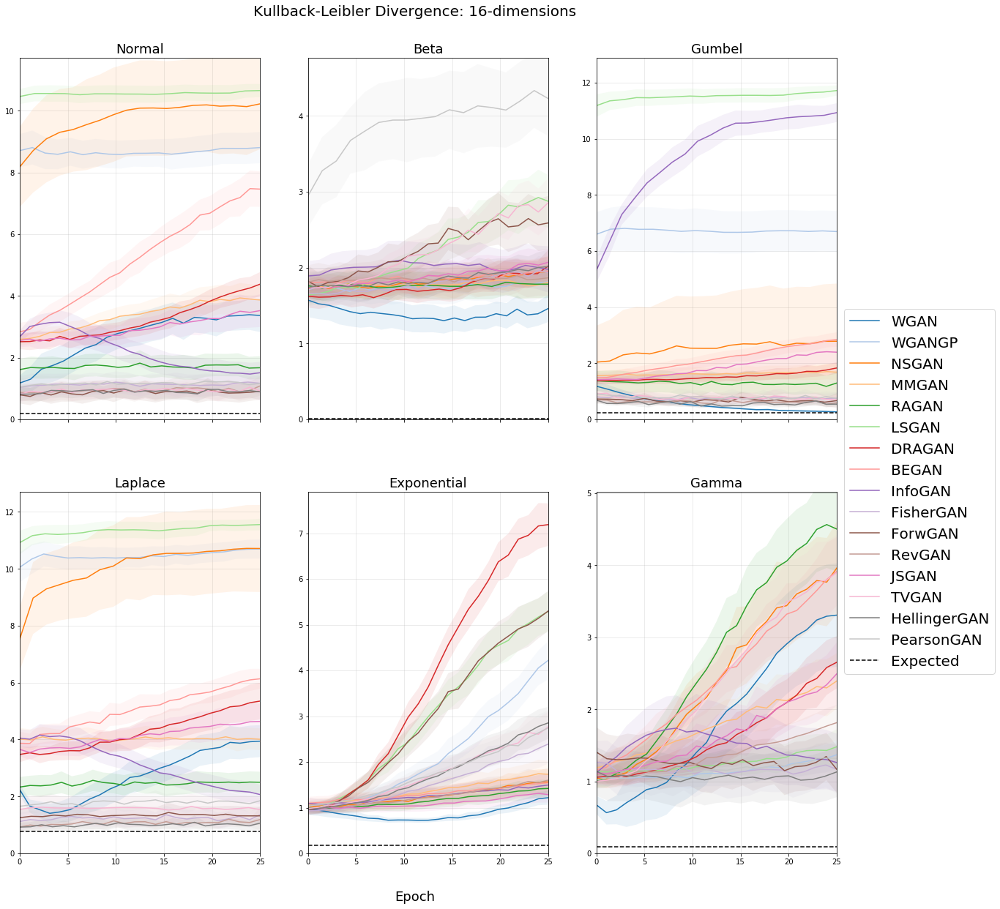

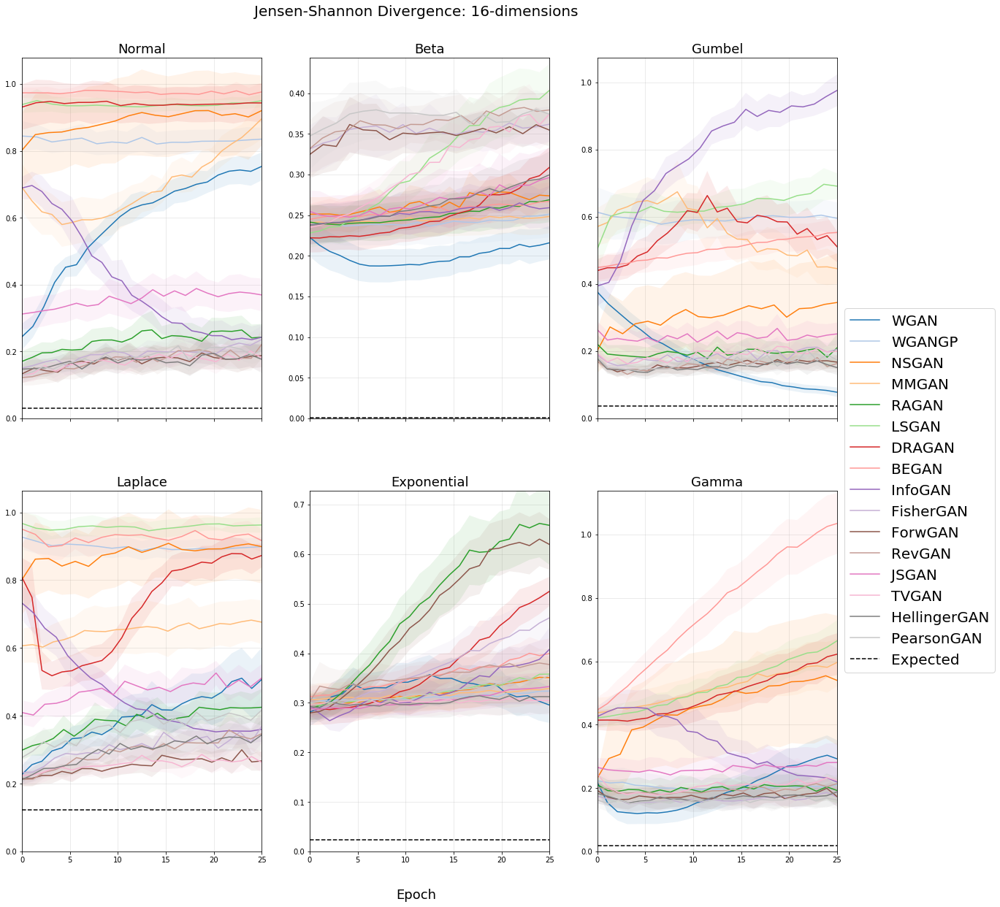

/Users/sob/github/gans6883/env/lib/python3.6/site-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/Users/sob/github/gans6883/env/lib/python3.6/site-packages/ipykernel_launcher.py:118: RuntimeWarning: invalid value encountered in true_divide
/Users/sob/github/gans6883/env/lib/python3.6/site-packages/ipykernel_launcher.py:120: RuntimeWarning: invalid value encountered in greater


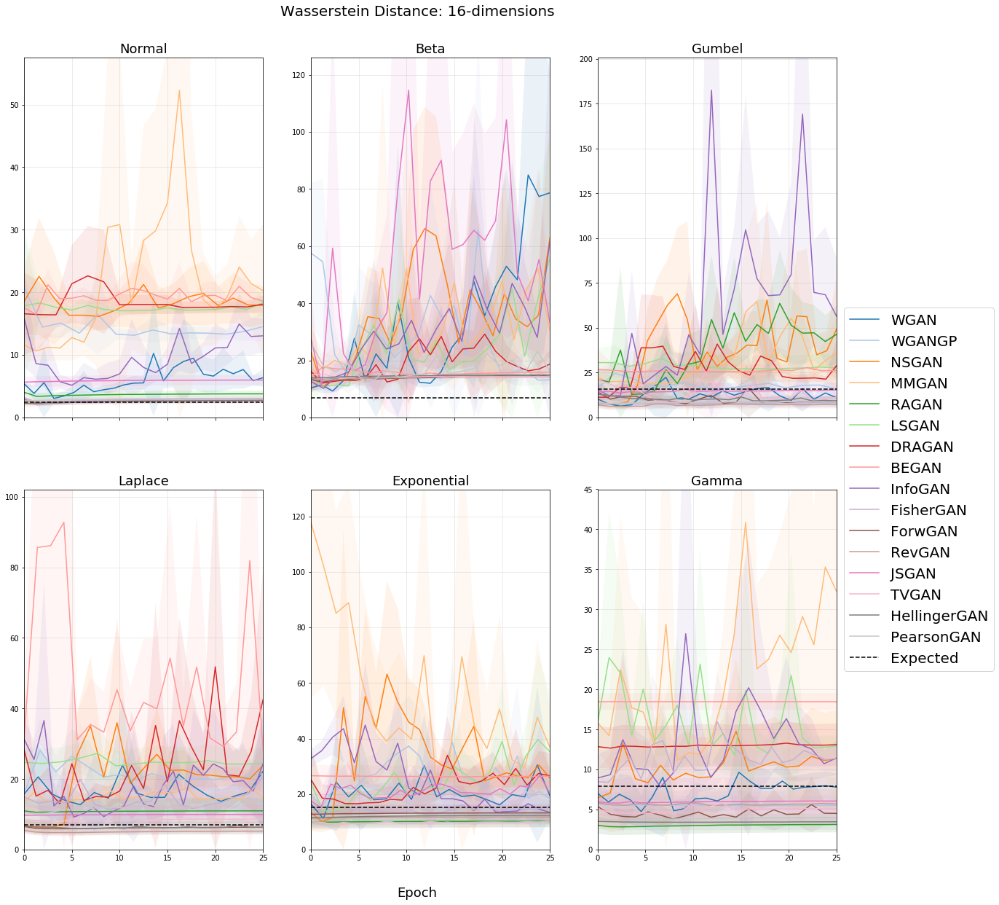

 Plot mean performance across epochs for 10k samples


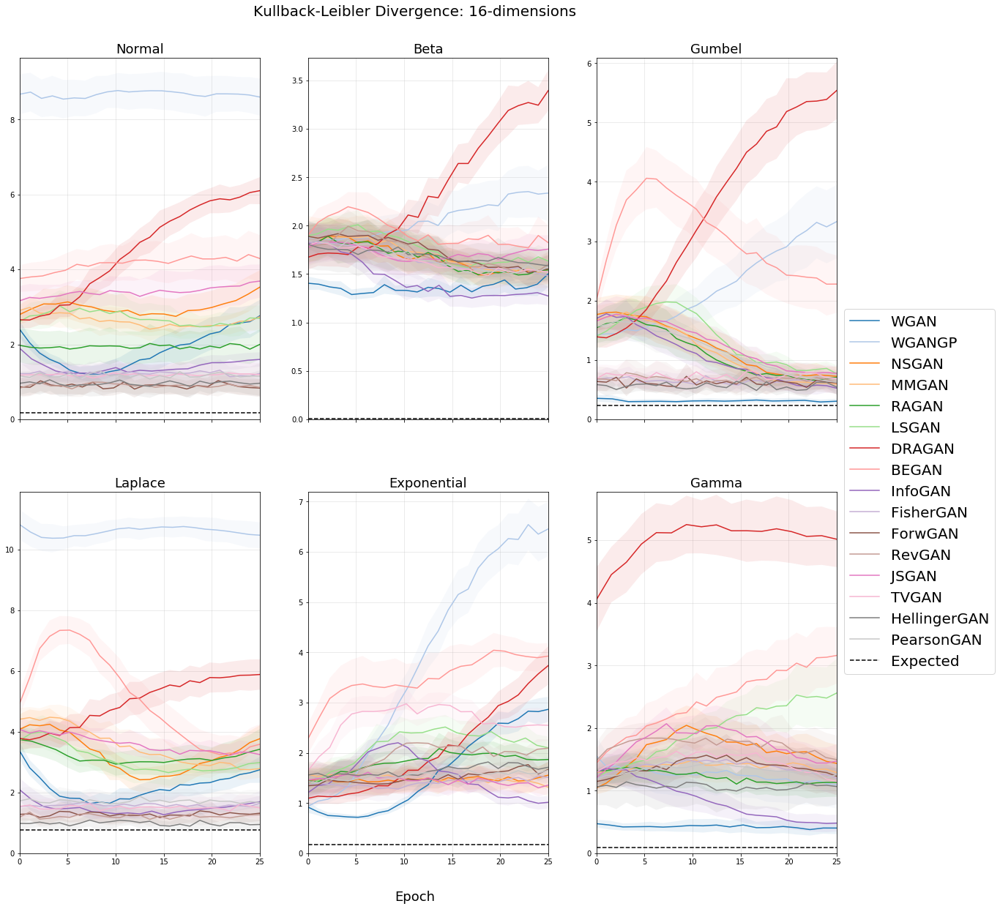

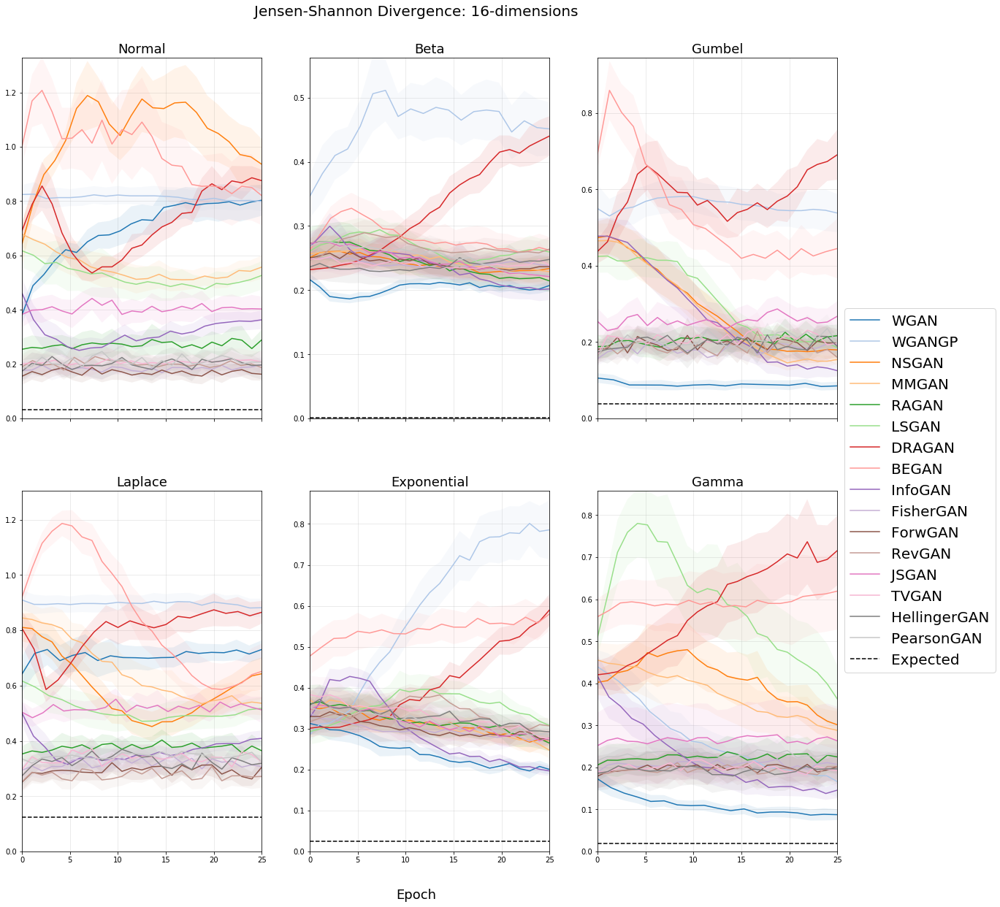

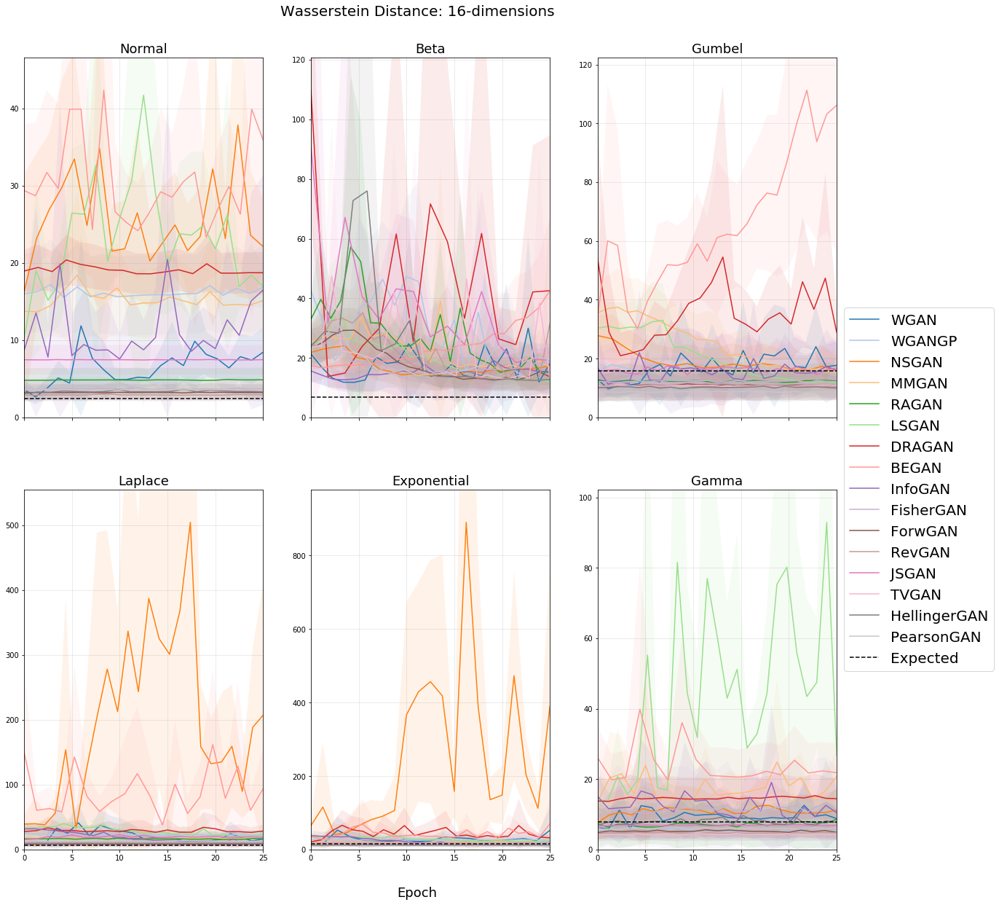

 Plot mean performance across epochs for 100k samples


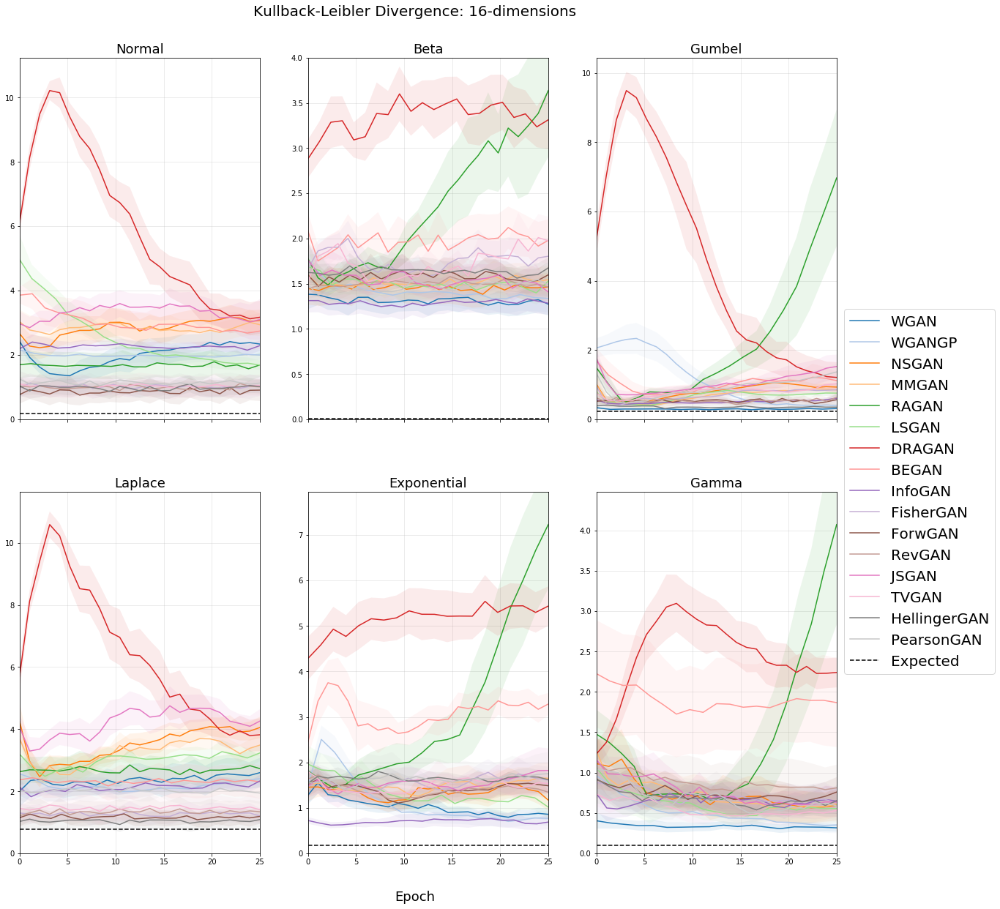

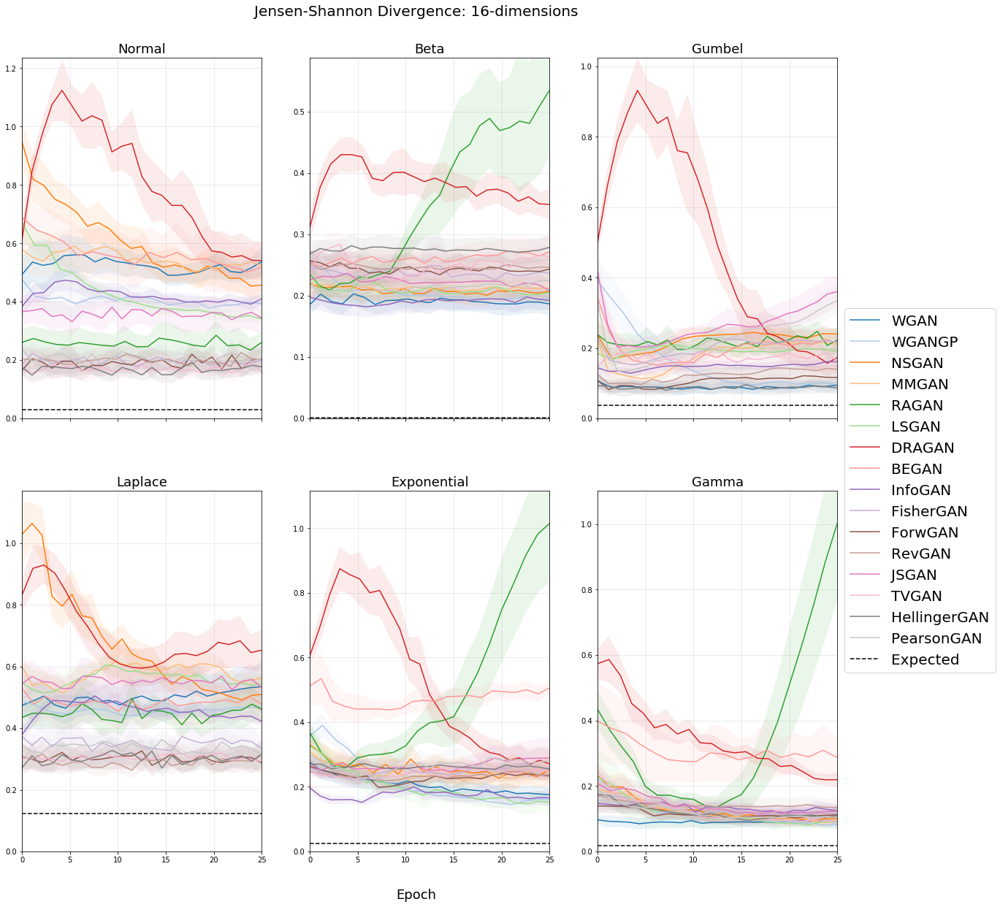

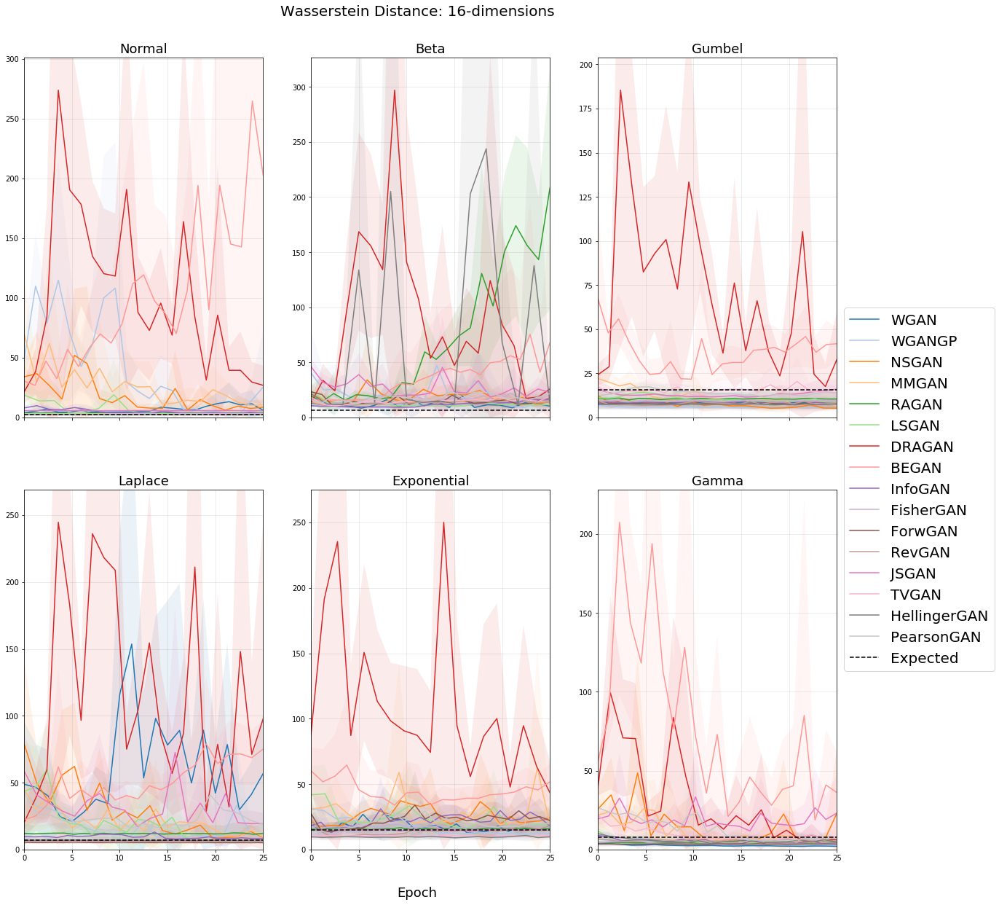

32
 Plot mean performance across epochs for 1k samples


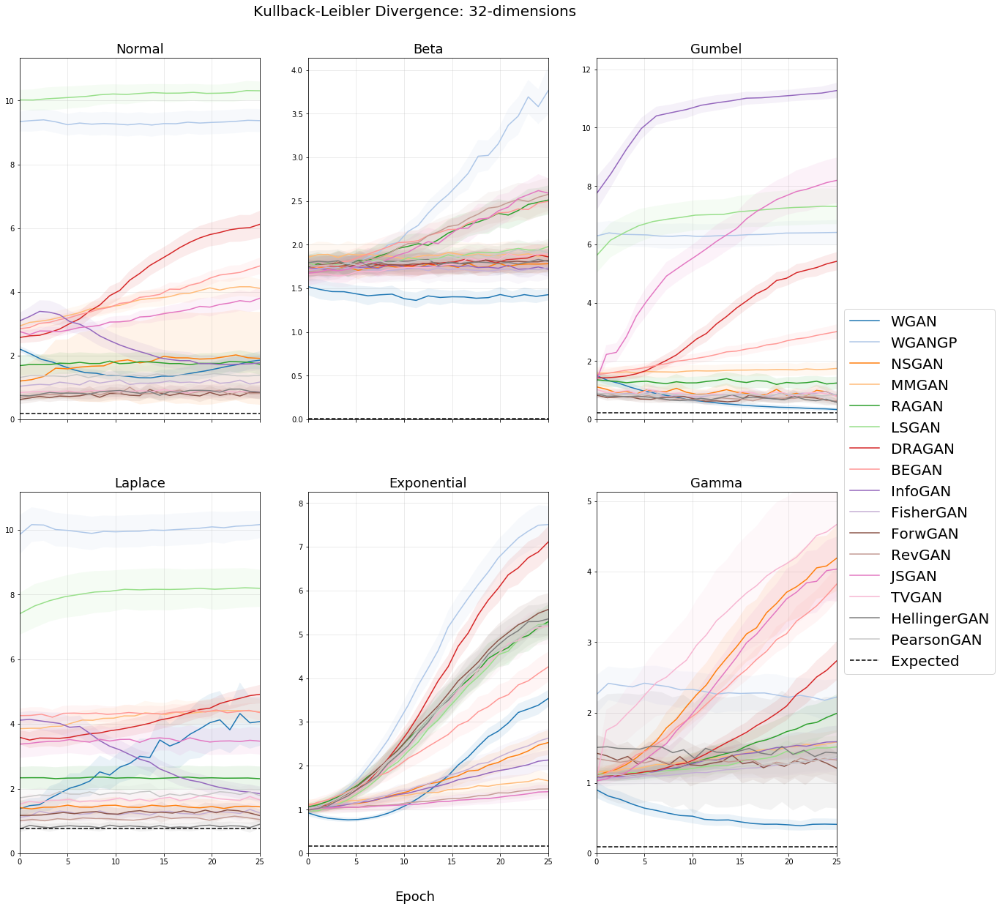

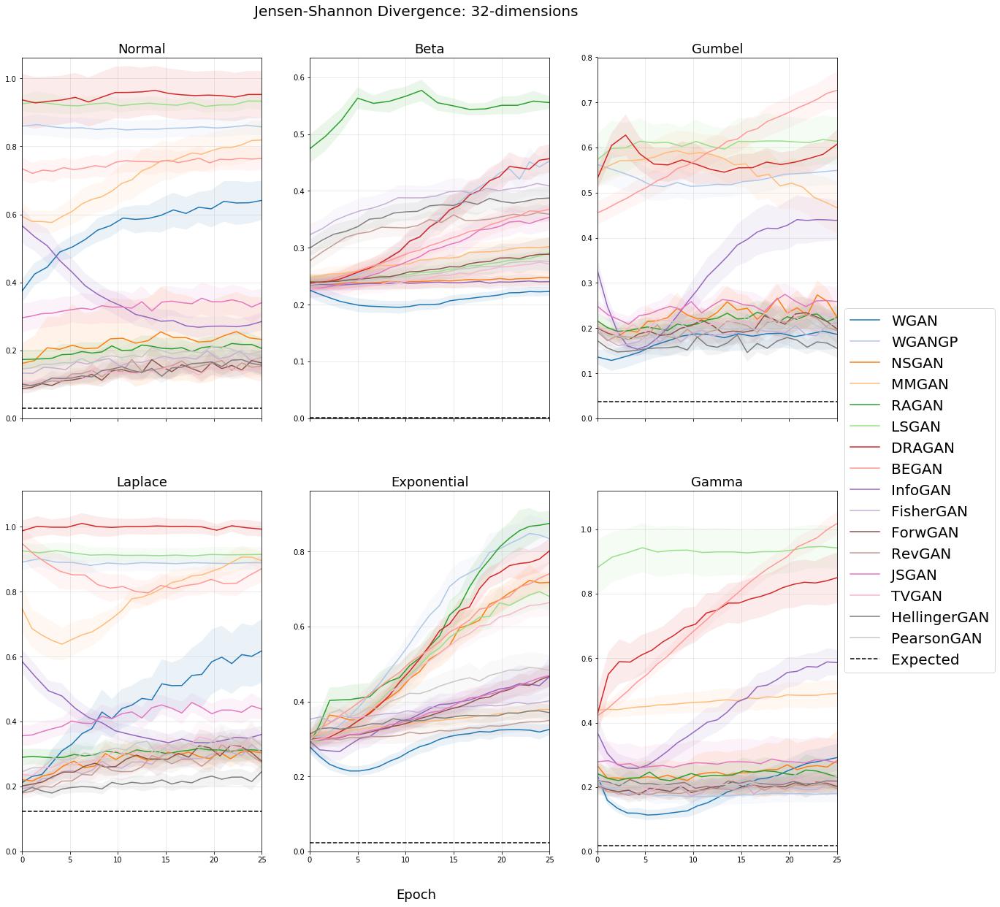

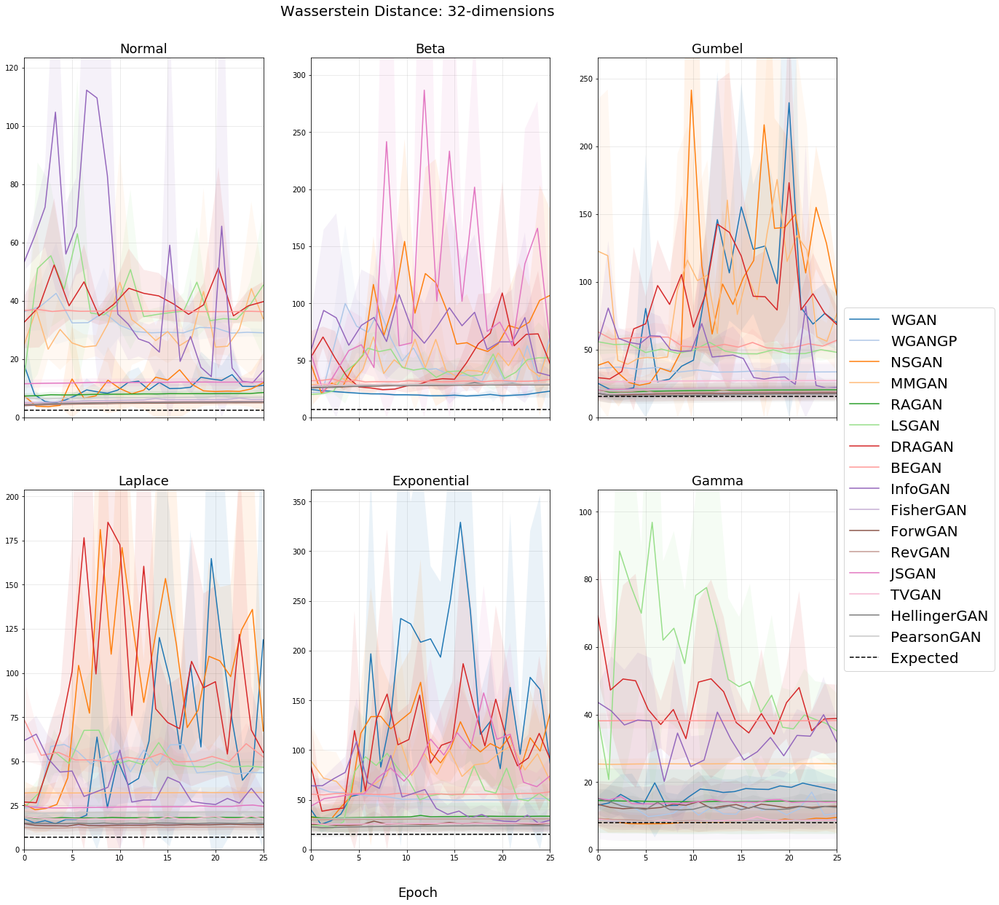

 Plot mean performance across epochs for 10k samples


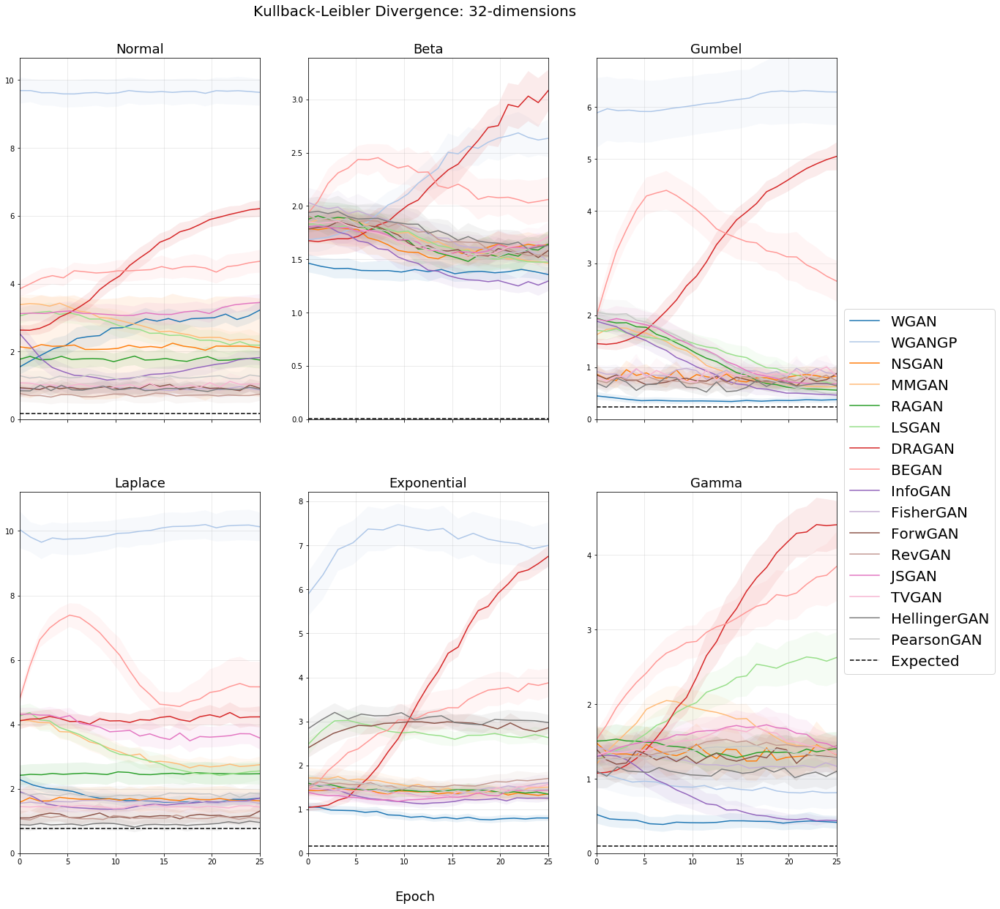

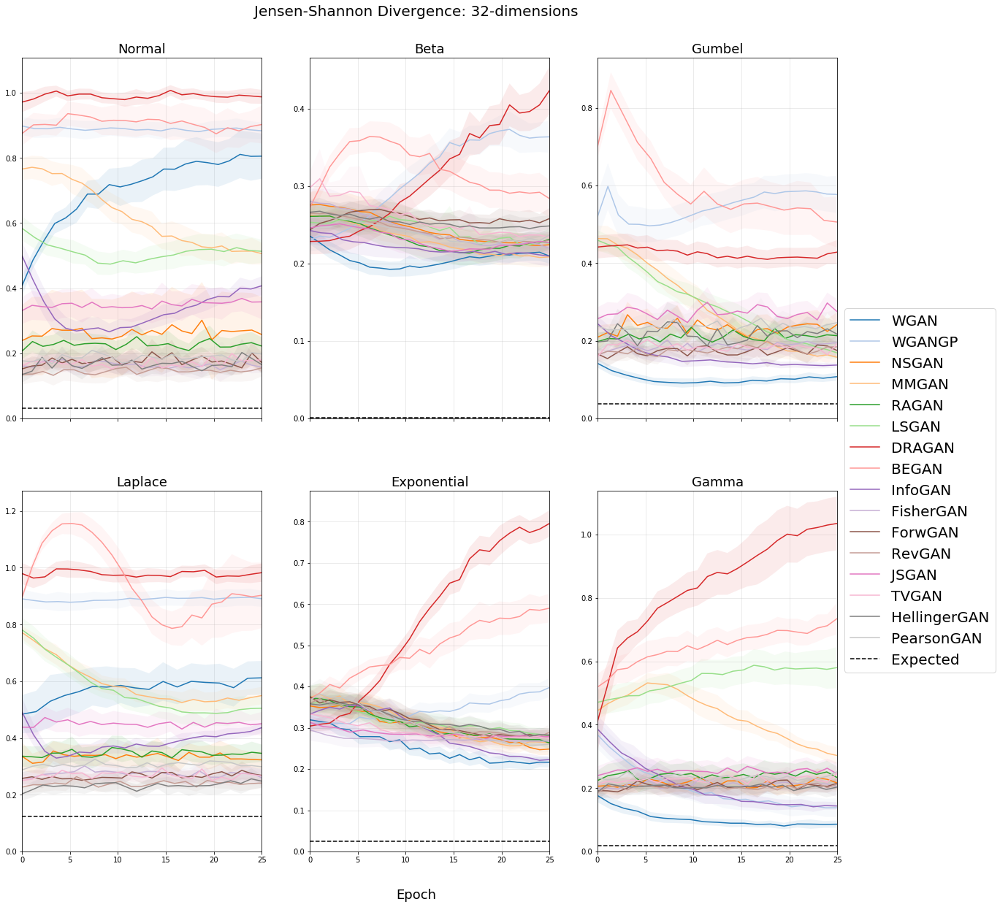

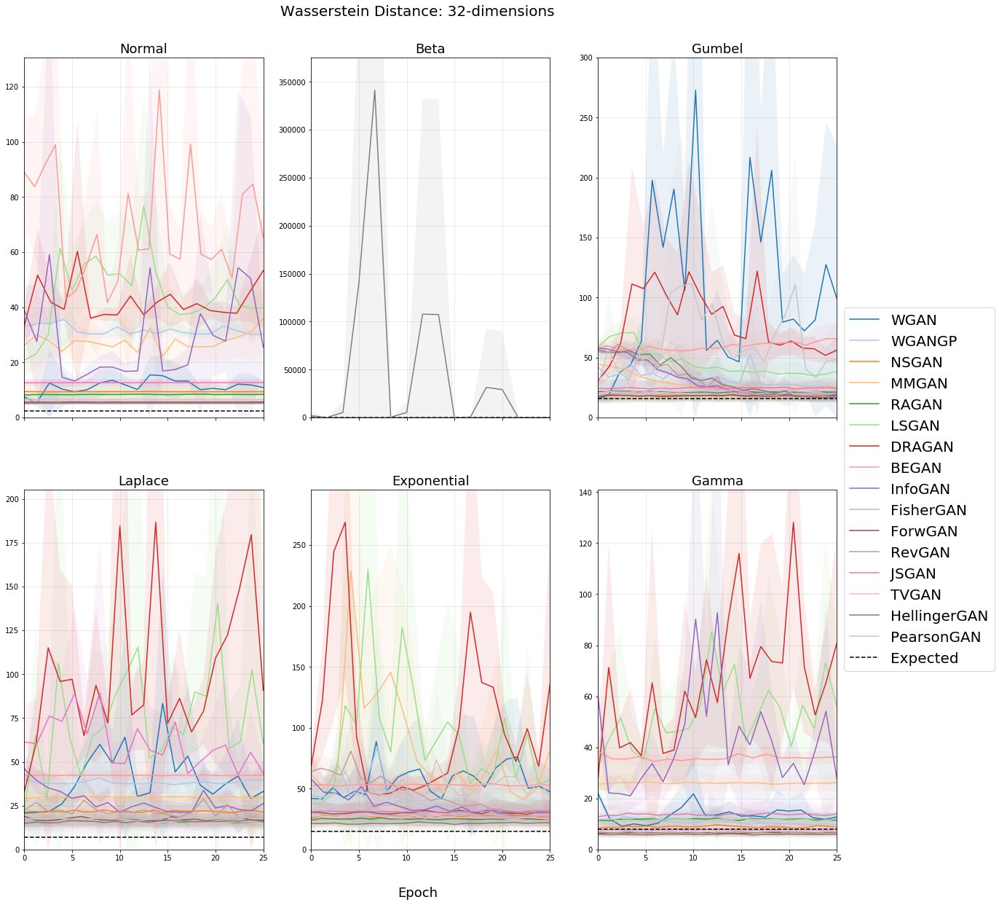

 Plot mean performance across epochs for 100k samples


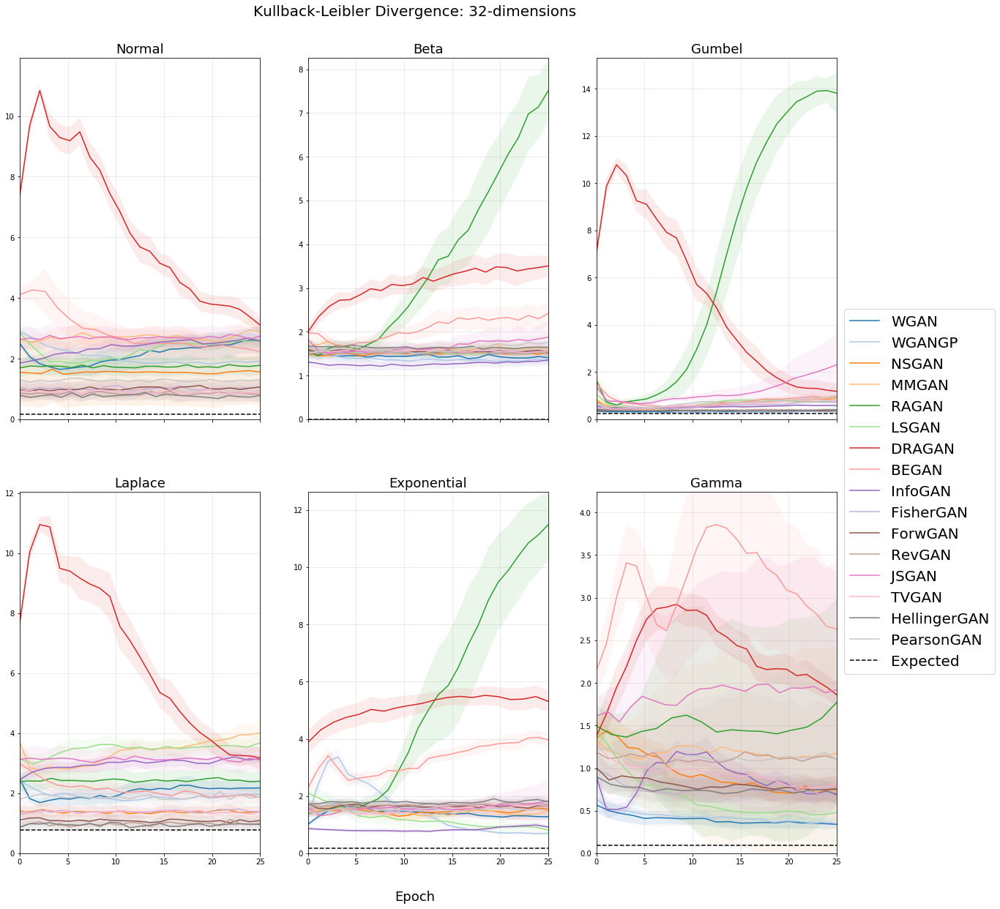

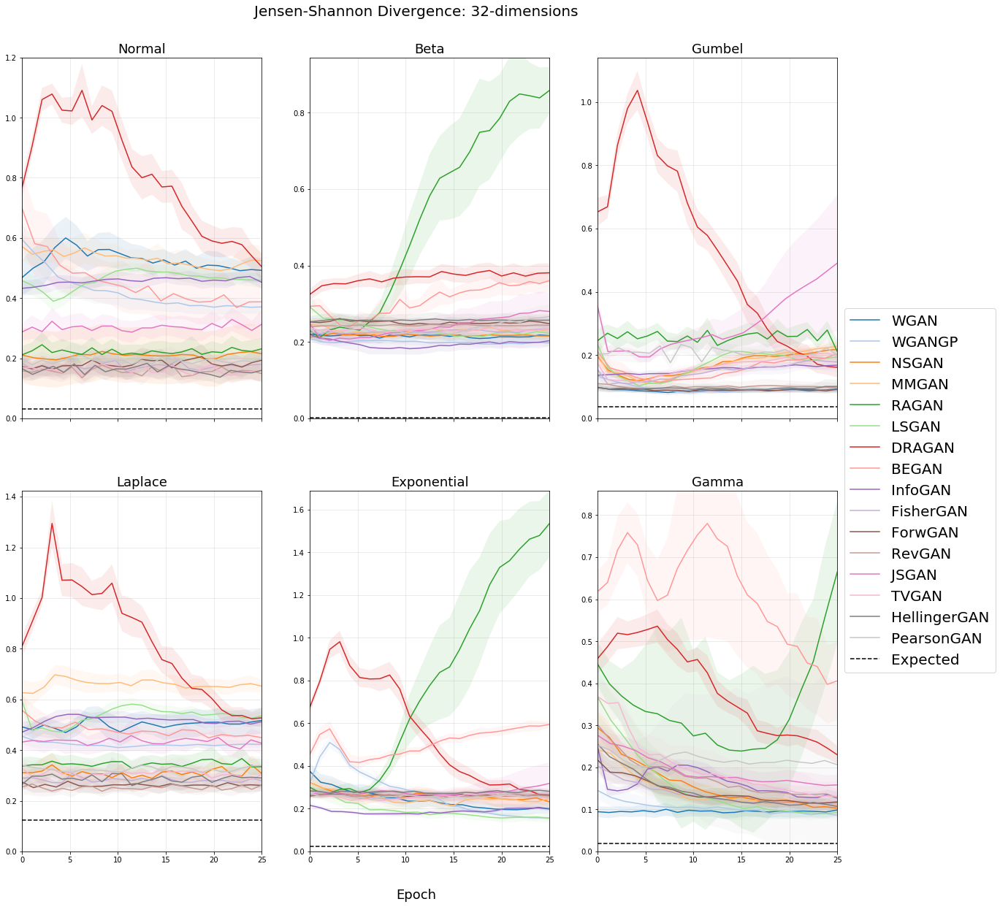

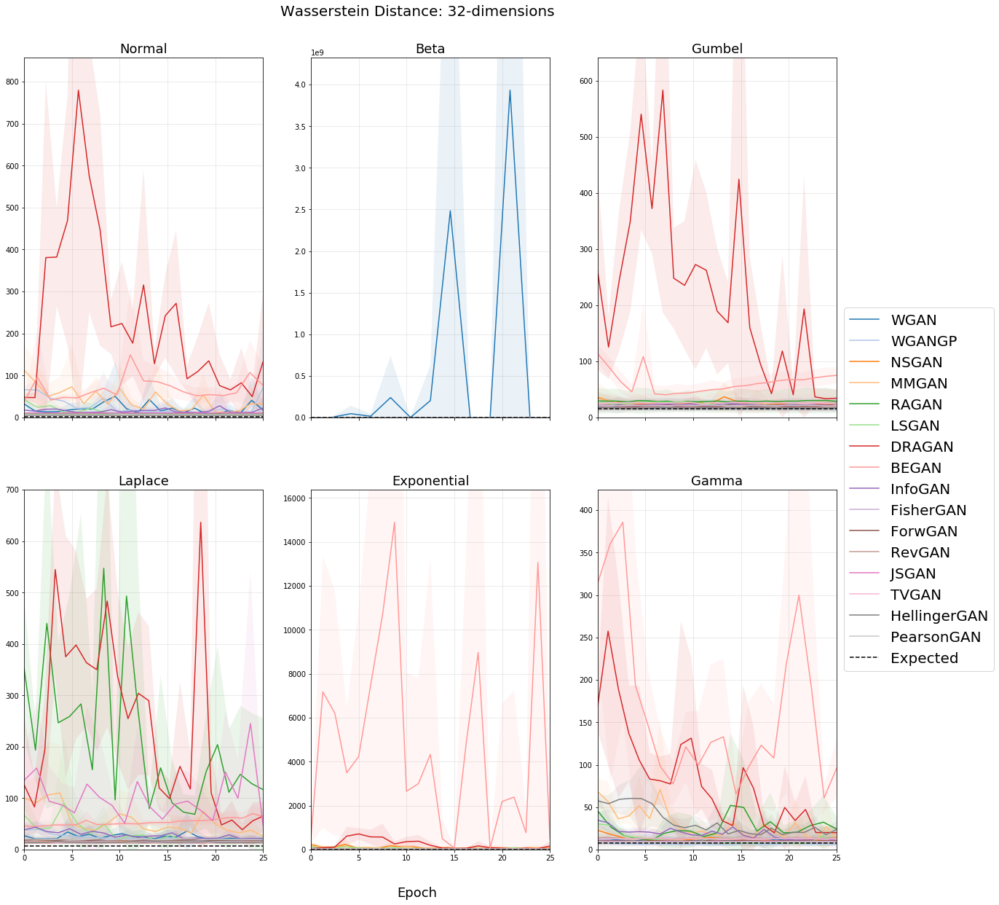

64
 Plot mean performance across epochs for 1k samples


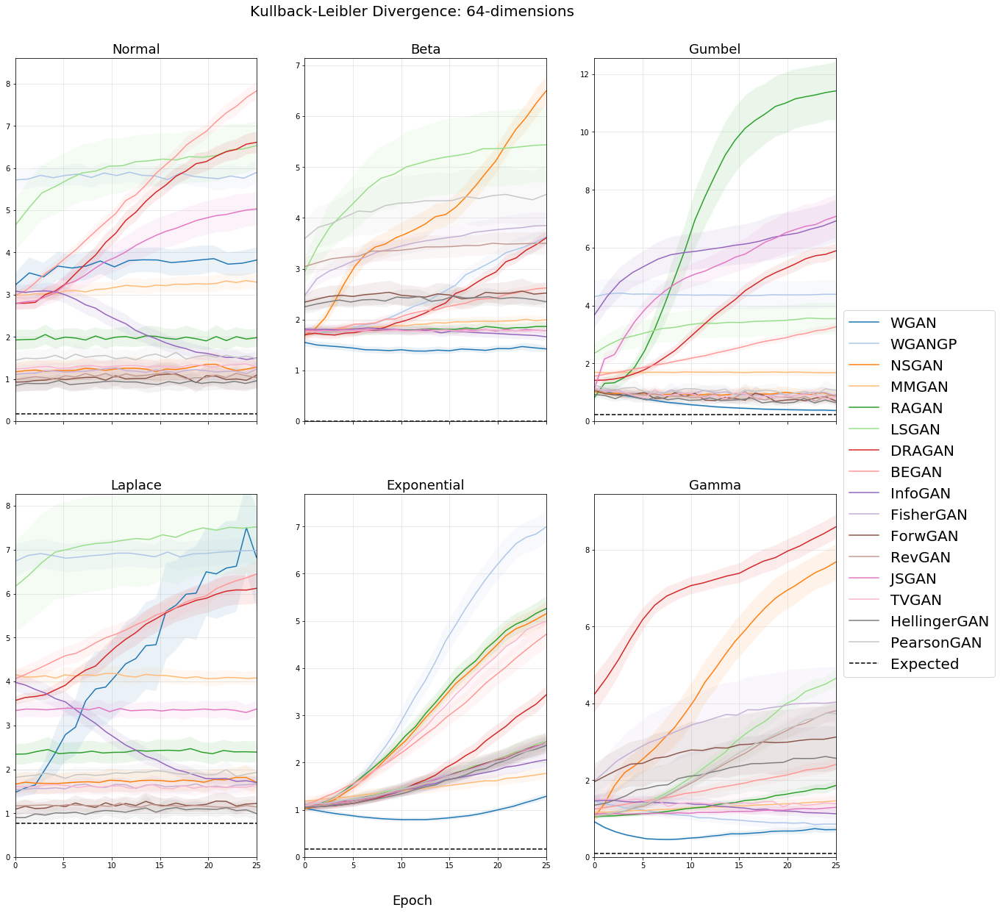

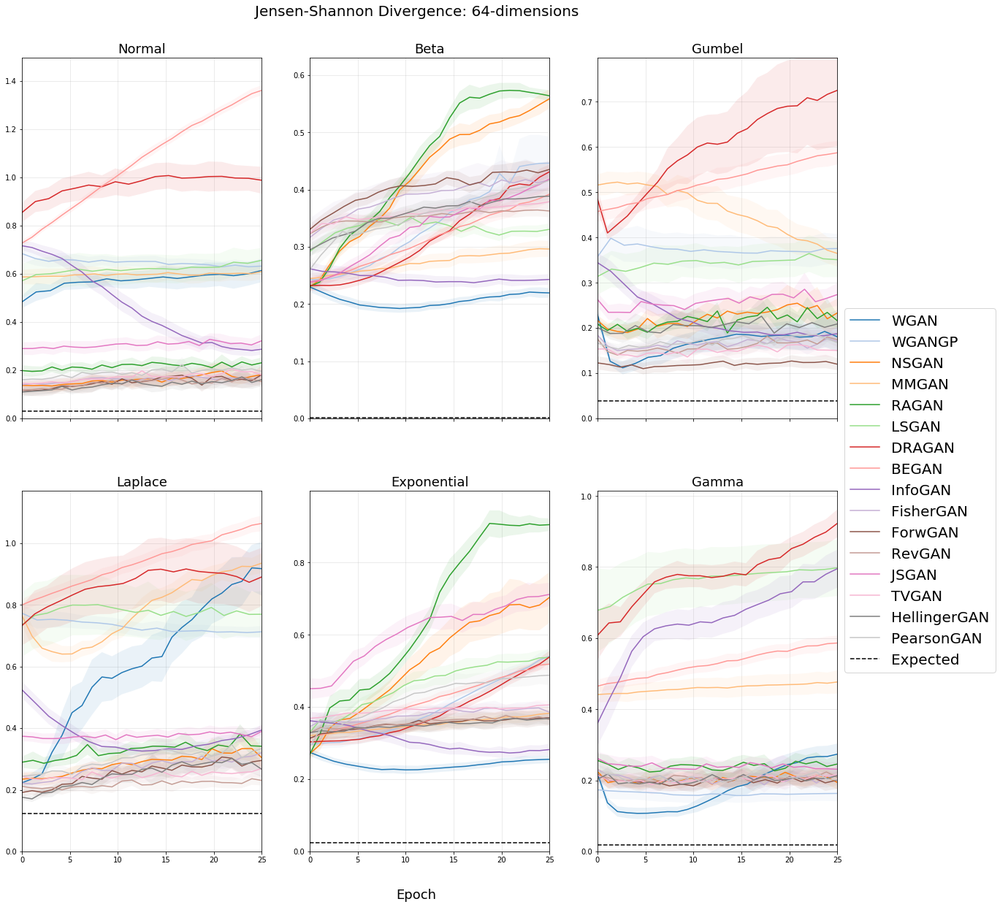

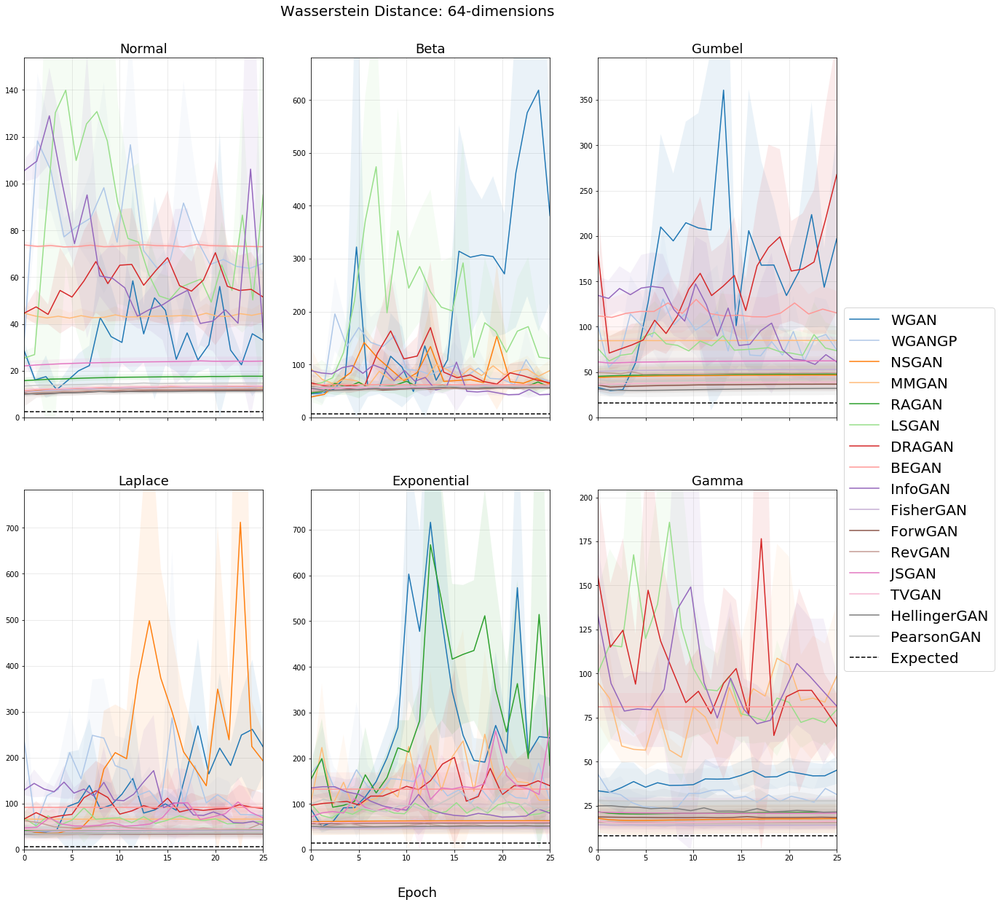

 Plot mean performance across epochs for 10k samples


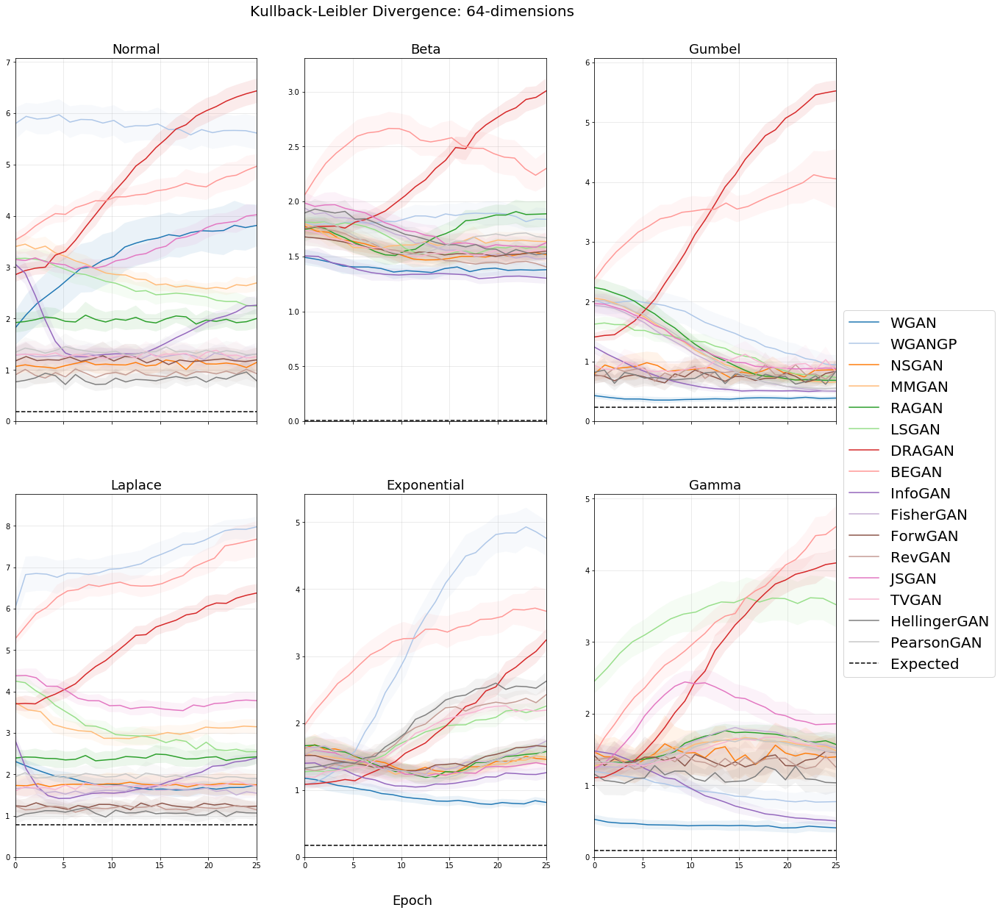

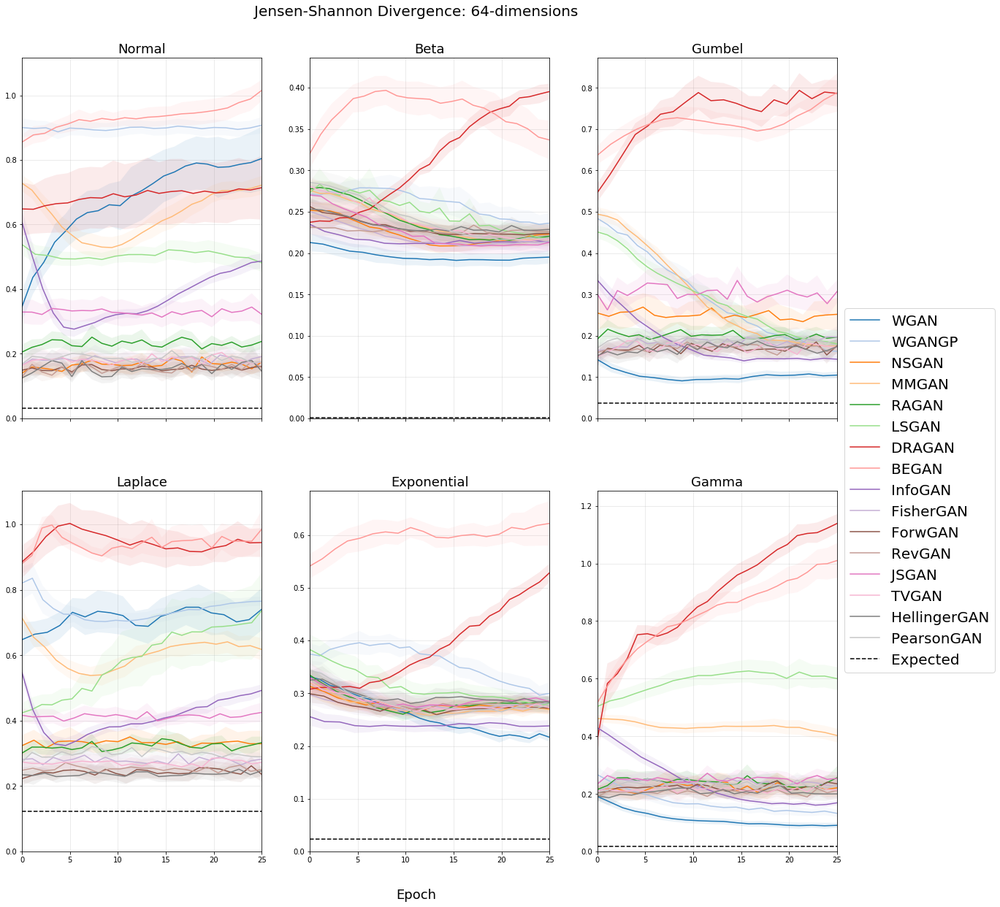

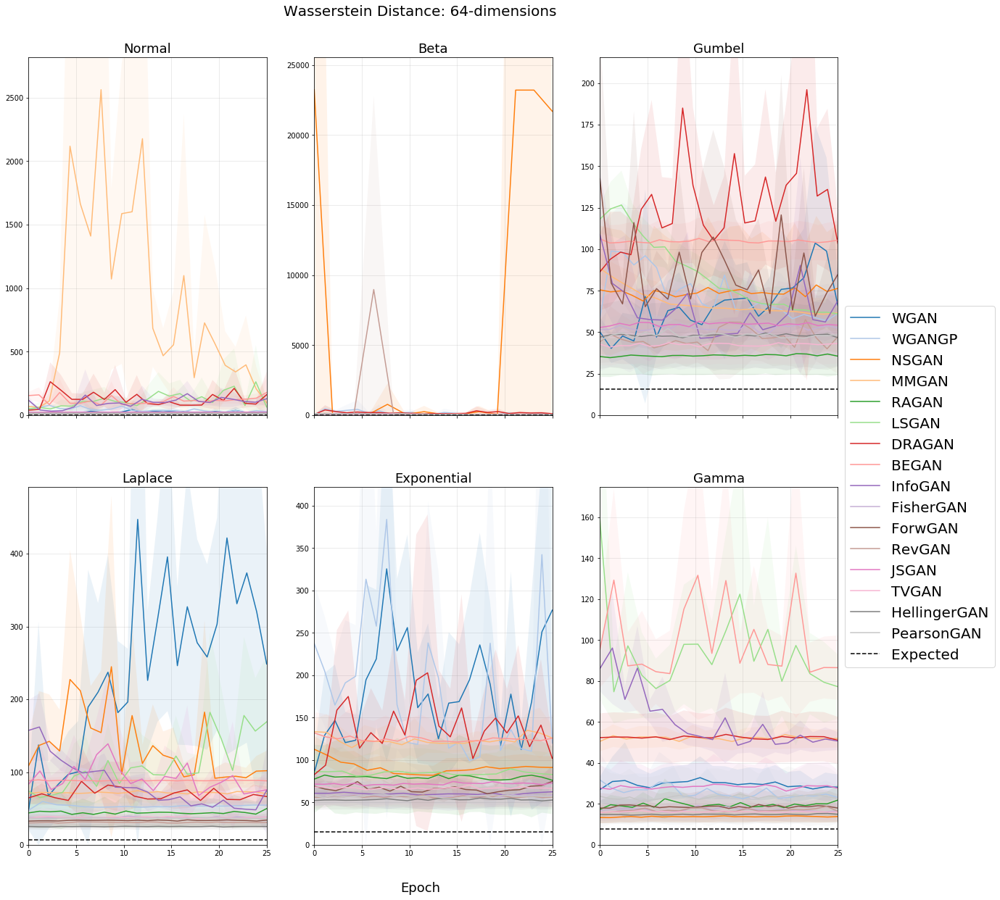

 Plot mean performance across epochs for 100k samples


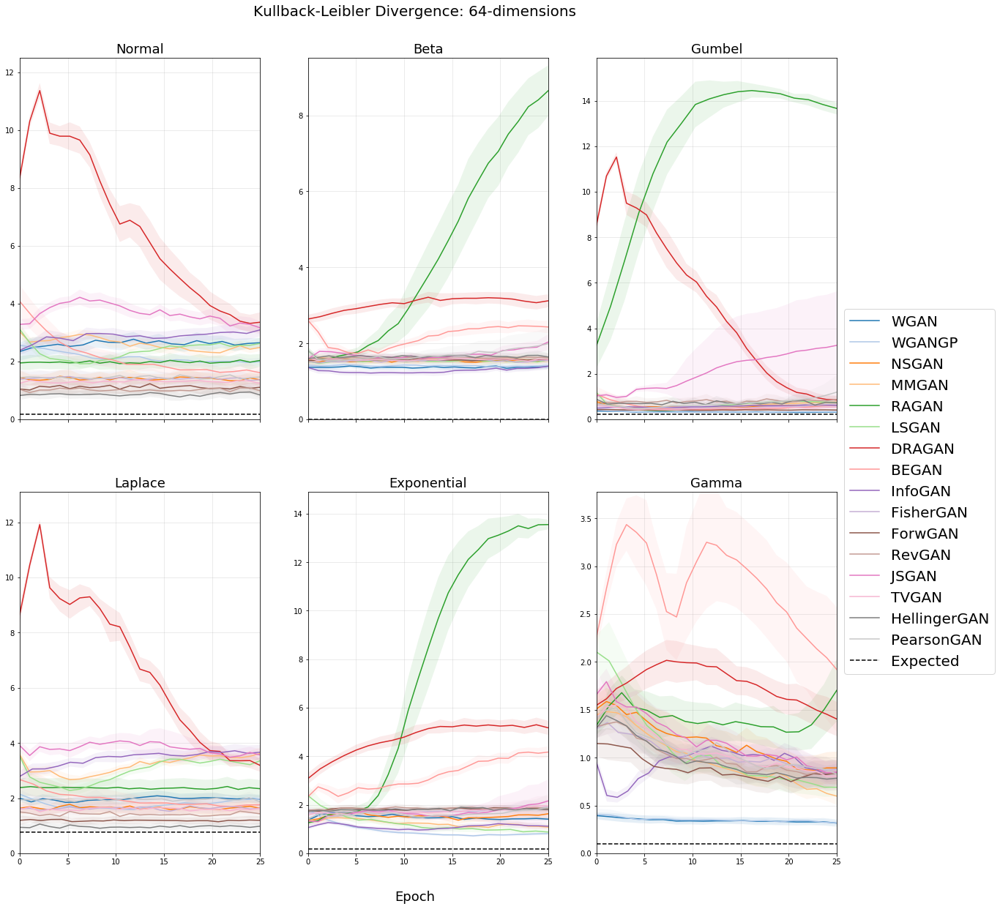

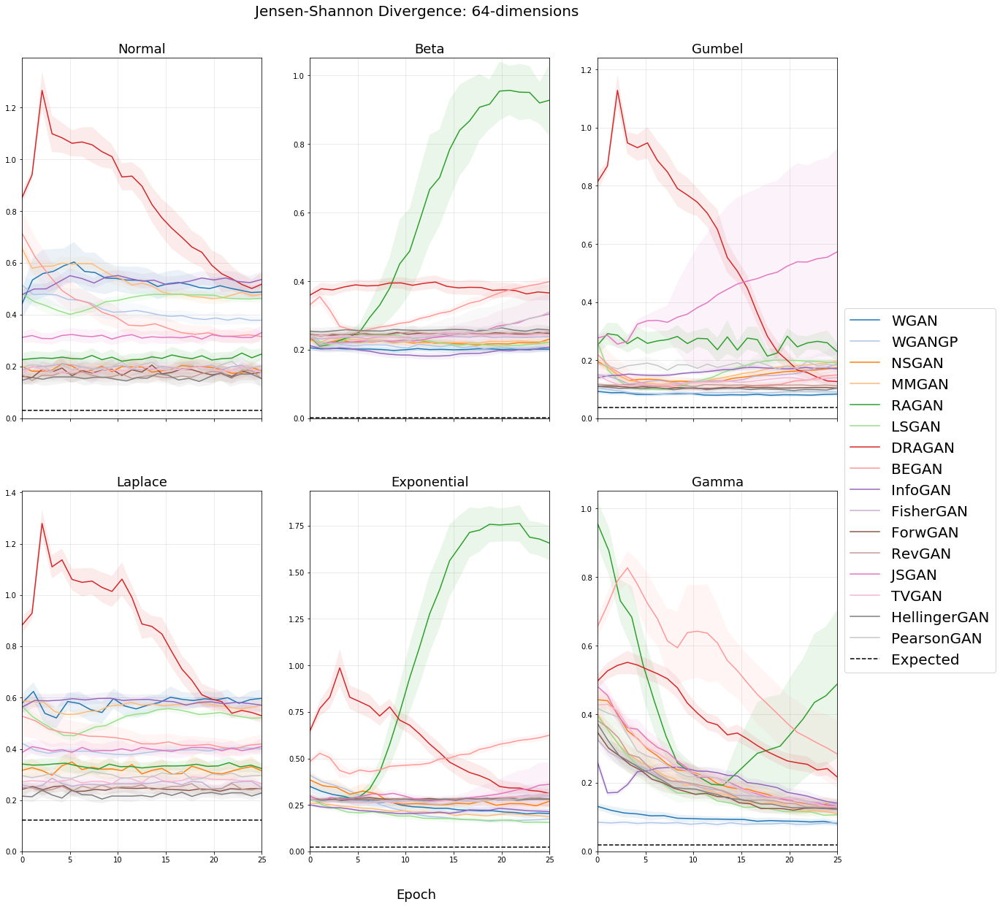

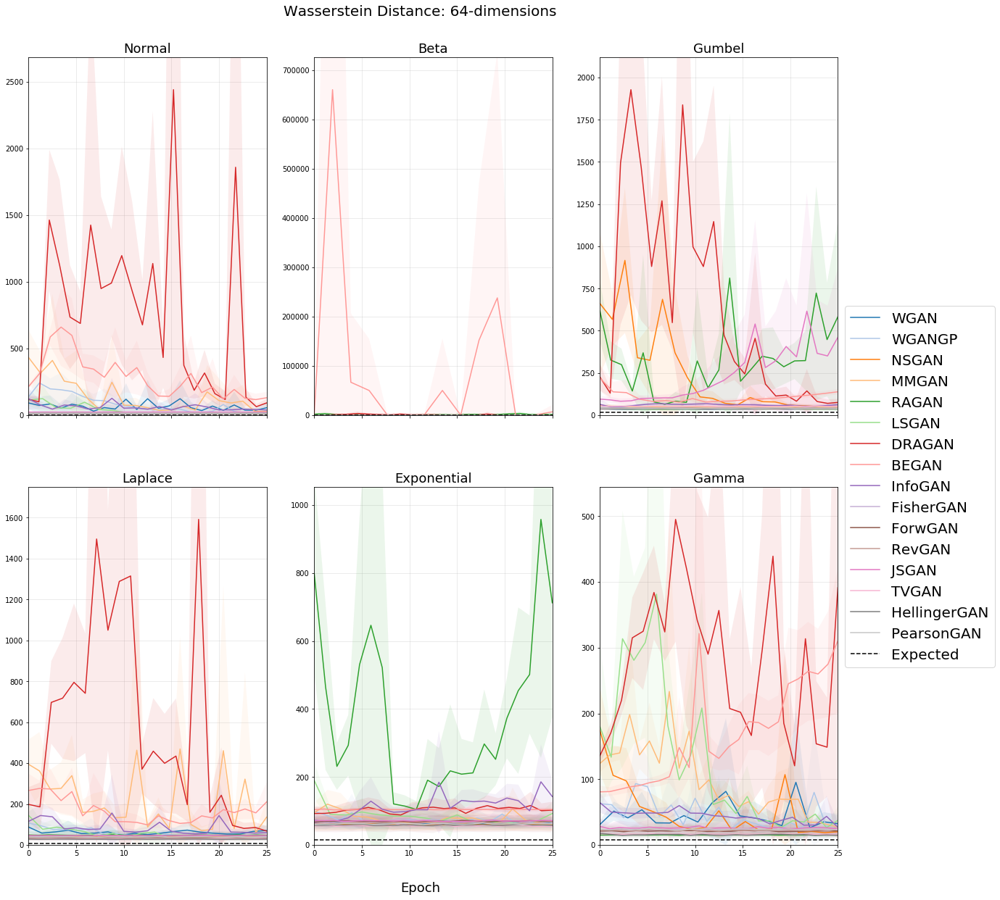

128
 Plot mean performance across epochs for 1k samples


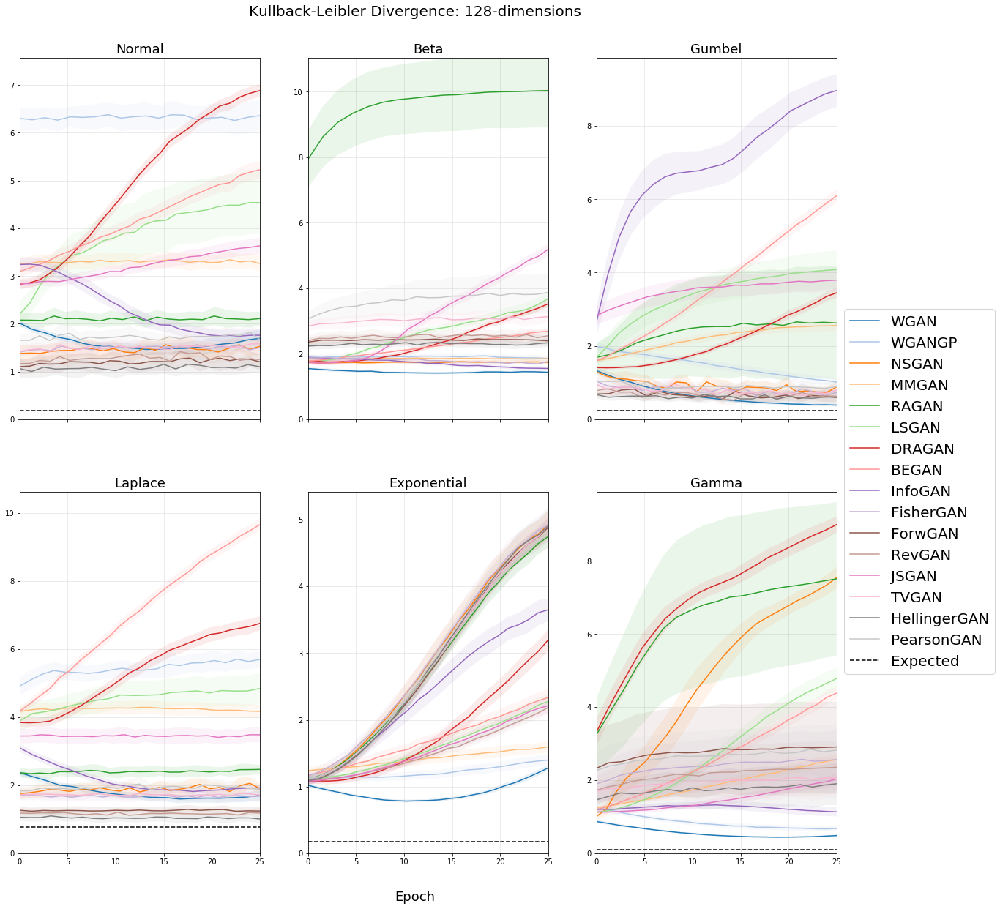

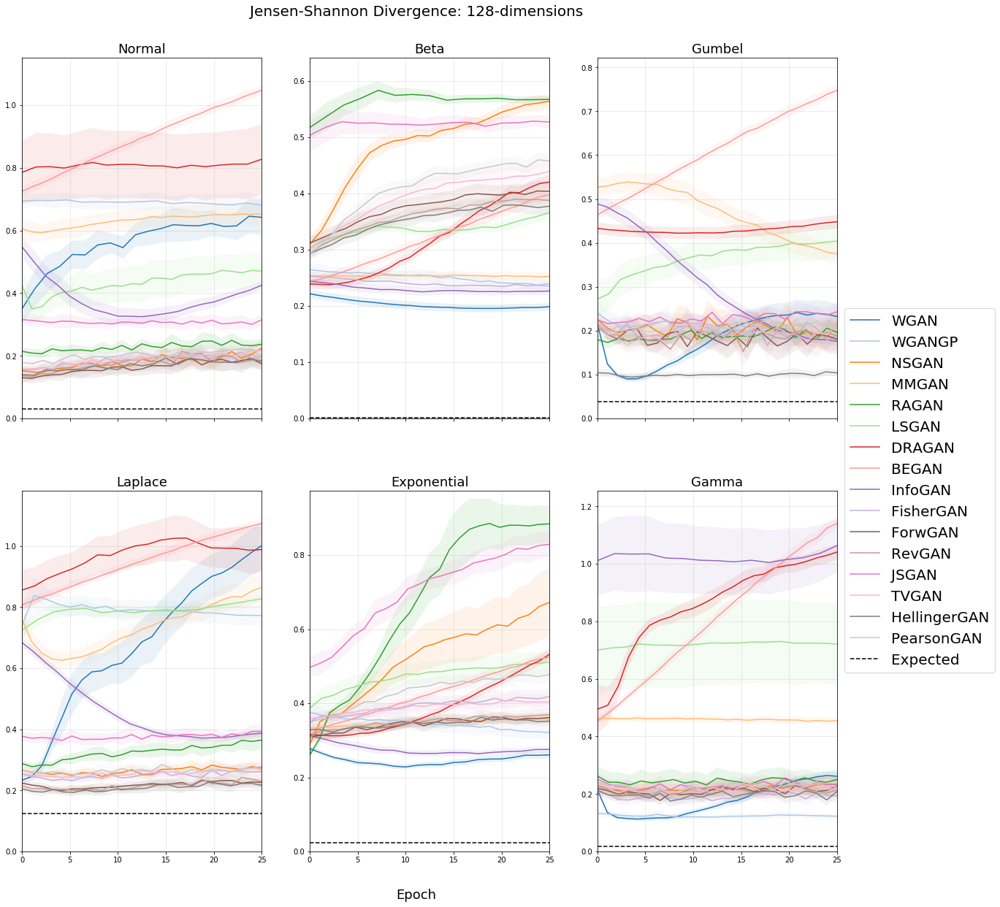

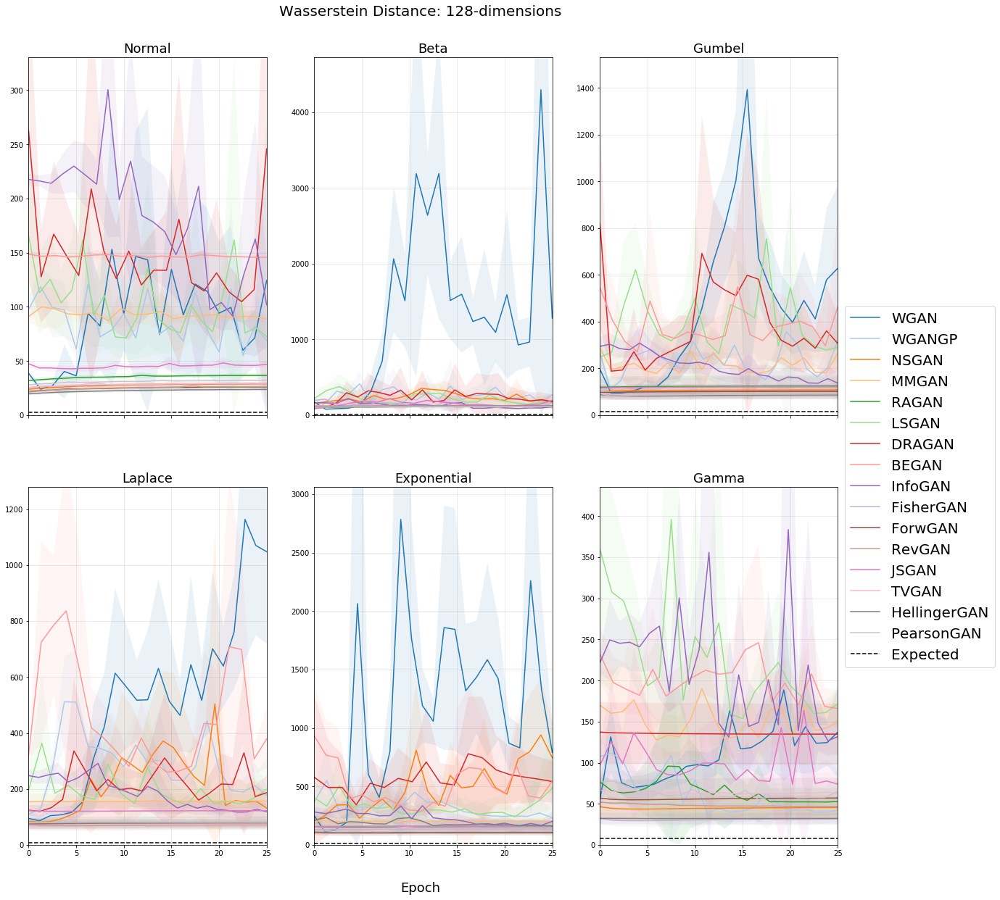

 Plot mean performance across epochs for 10k samples


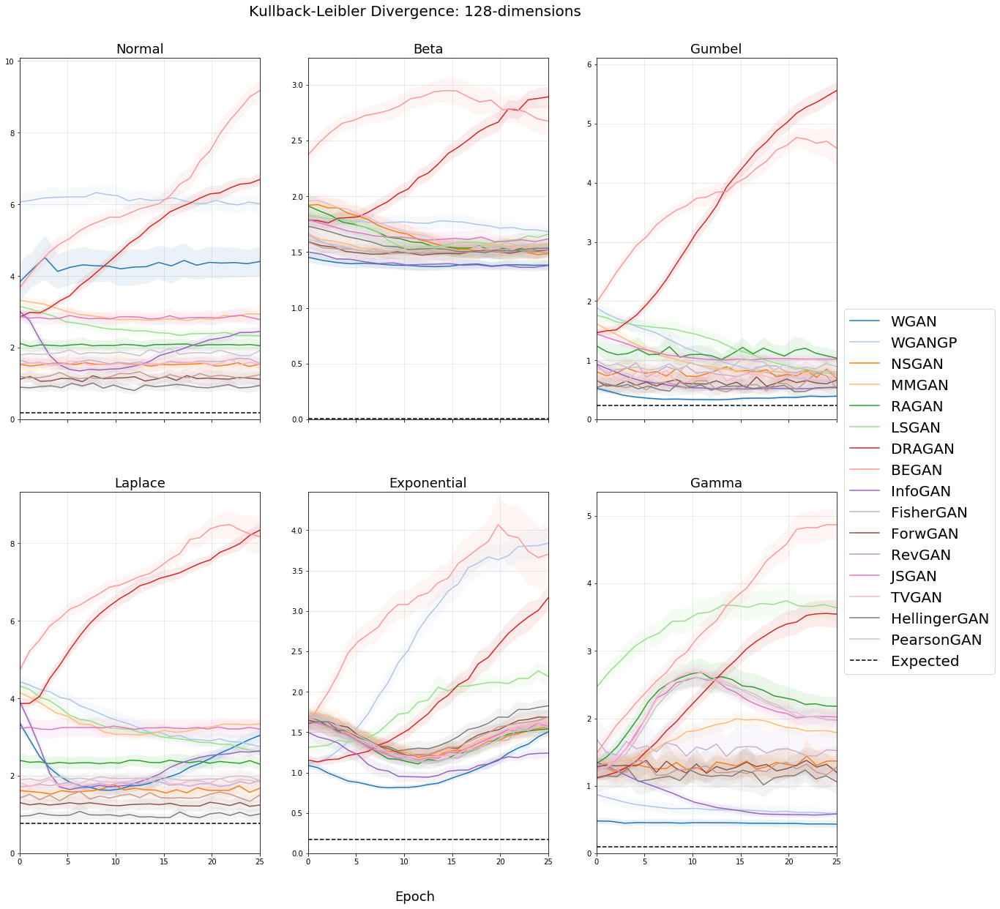

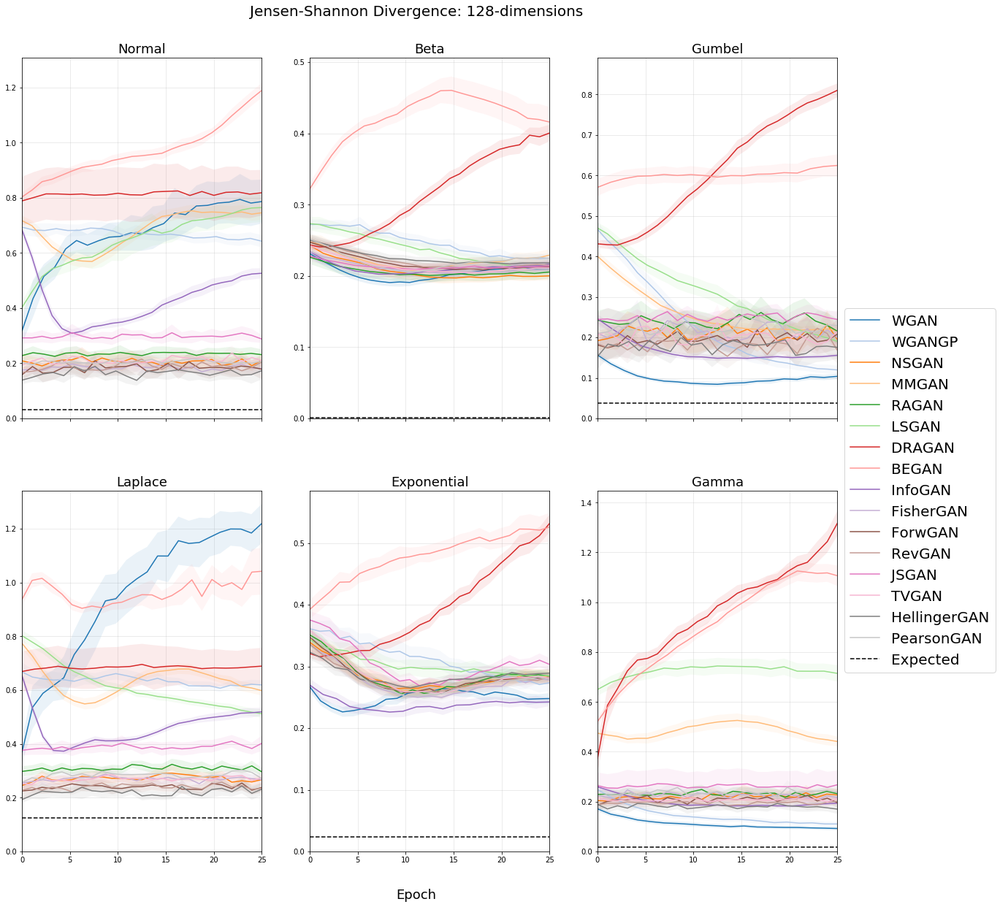

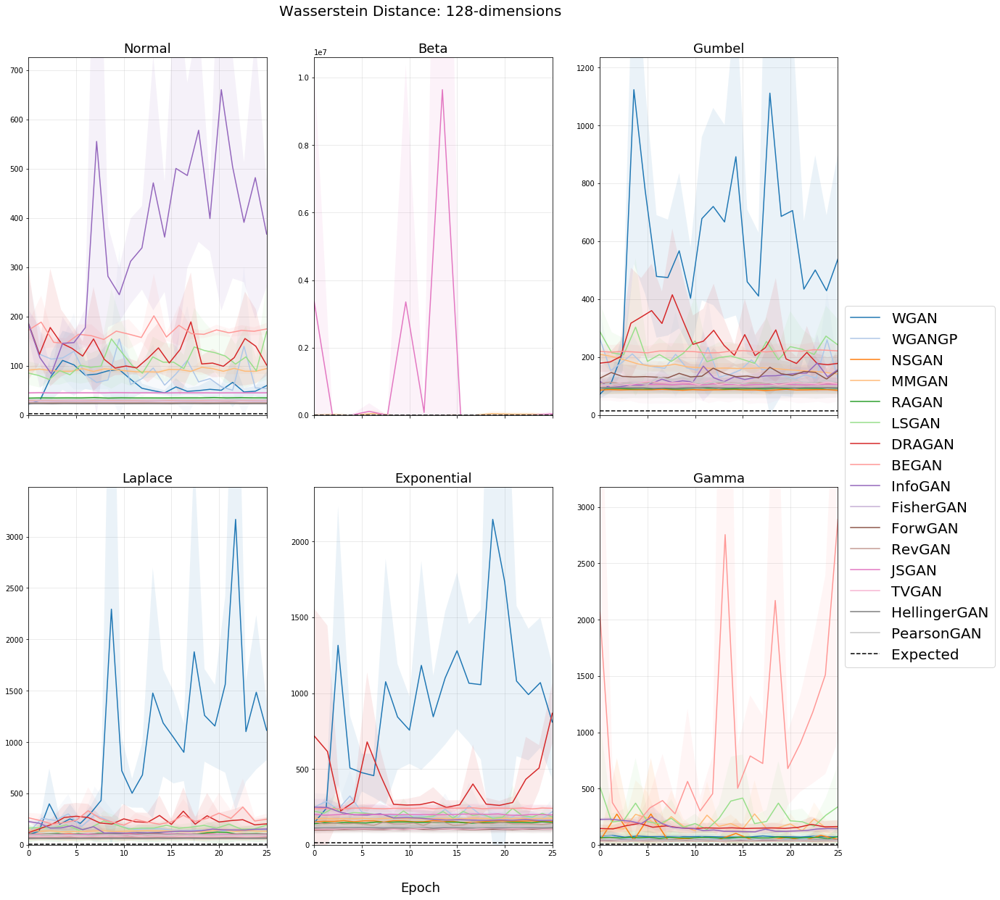

 Plot mean performance across epochs for 100k samples


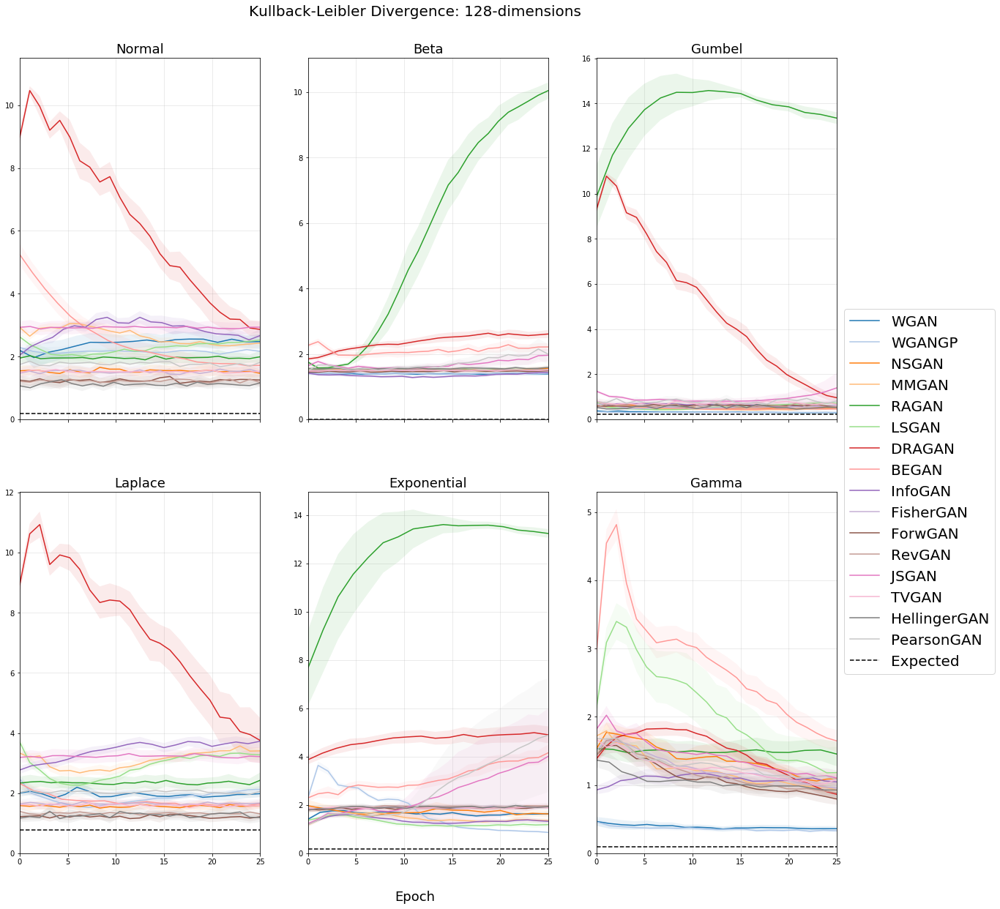

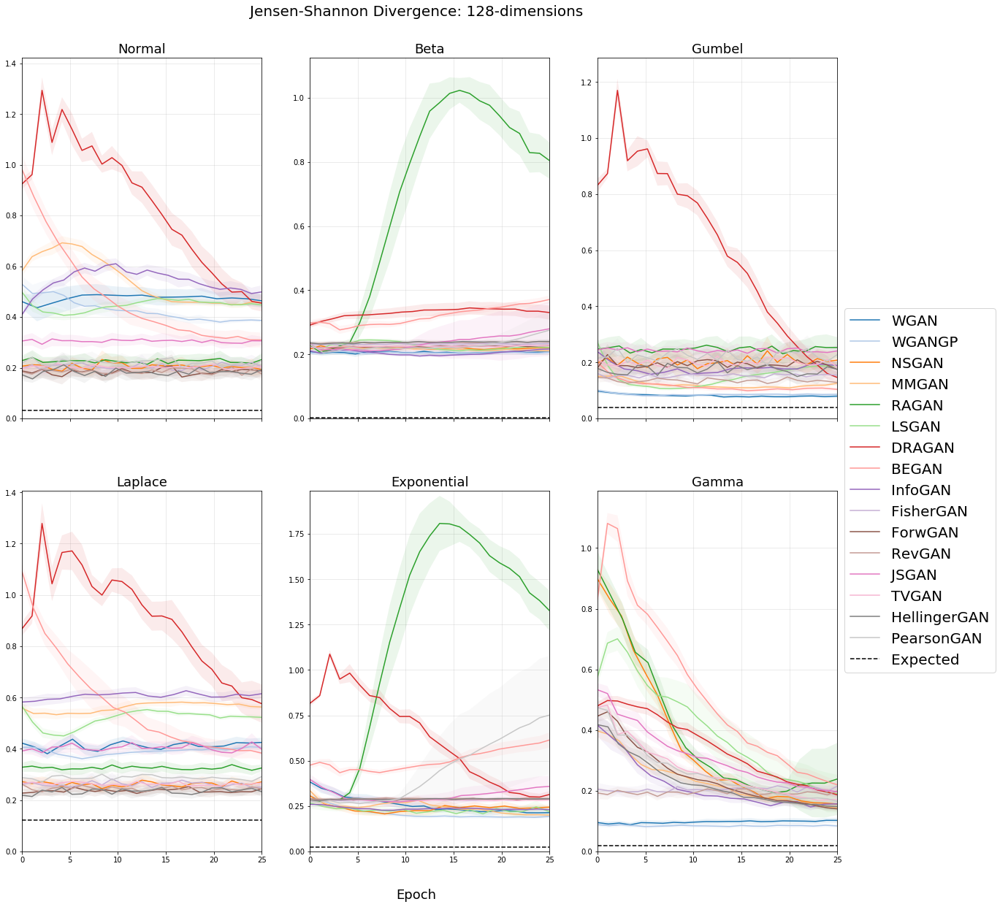

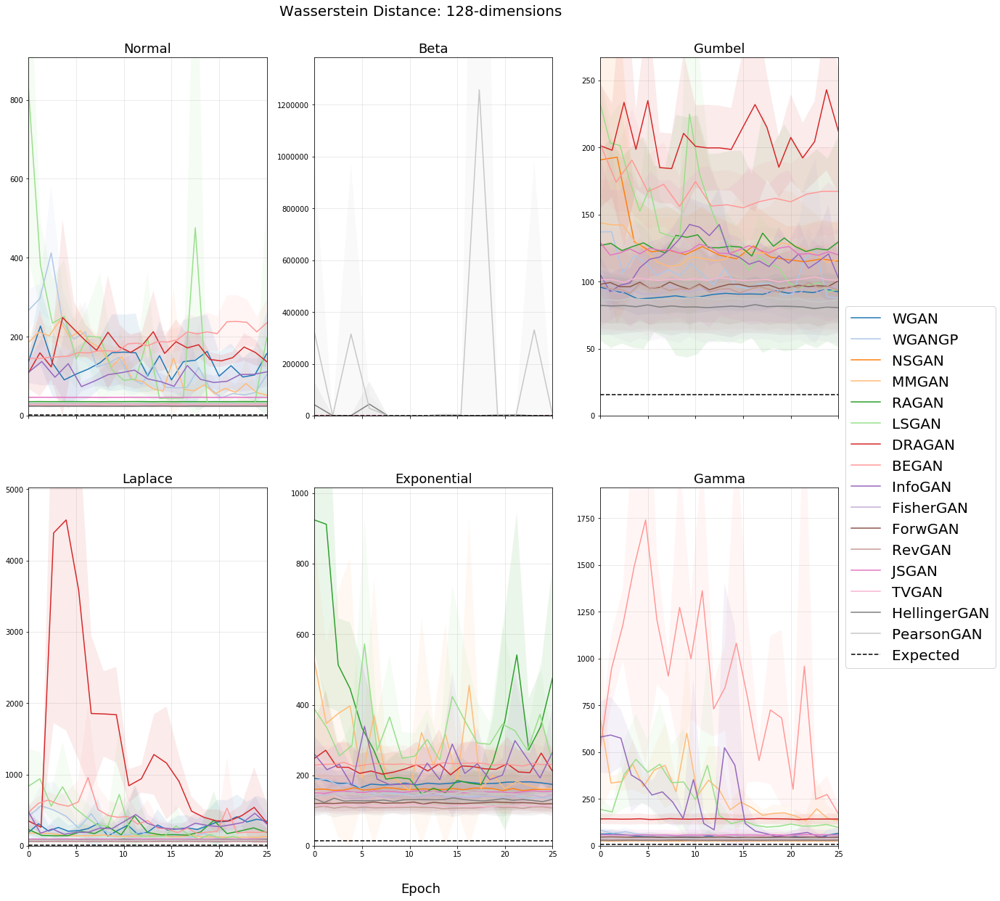

In [66]:
for d in [16, 32, 64, 128]:
    print(d)
    optimal_1000 = load_best('/Users/sob/Desktop/gan_results/best_1024/multivariate/{0}_dims_1000_samples/data.json'.format(d))
    optimal_10000 = load_best('/Users/sob/Desktop/gan_results/best_1024/multivariate/{0}_dims_10000_samples/data.json'.format(d))
    optimal_100000 = load_best('/Users/sob/Desktop/gan_results/best_1024/multivariate/{0}_dims_100000_samples/data.json'.format(d))
    print(""" Plot mean performance across epochs for 1k samples""")
    graph_multivariate(optimal_1000, ci=True, omit_outliers=True, thresh=2.5, save=True, dims=d, samples=1000)
    print(""" Plot mean performance across epochs for 10k samples""")
    graph_multivariate(optimal_10000, ci=True, omit_outliers=True, thresh=3.0, save=True, dims=d, samples=10000)
    print(""" Plot mean performance across epochs for 100k samples""")
    graph_multivariate(optimal_100000, ci=True, omit_outliers=True, thresh=3.0, save=True, dims=d, samples=100000)

In [46]:
%matplotlib inline

 Plot mean performance across epochs for 1k samples


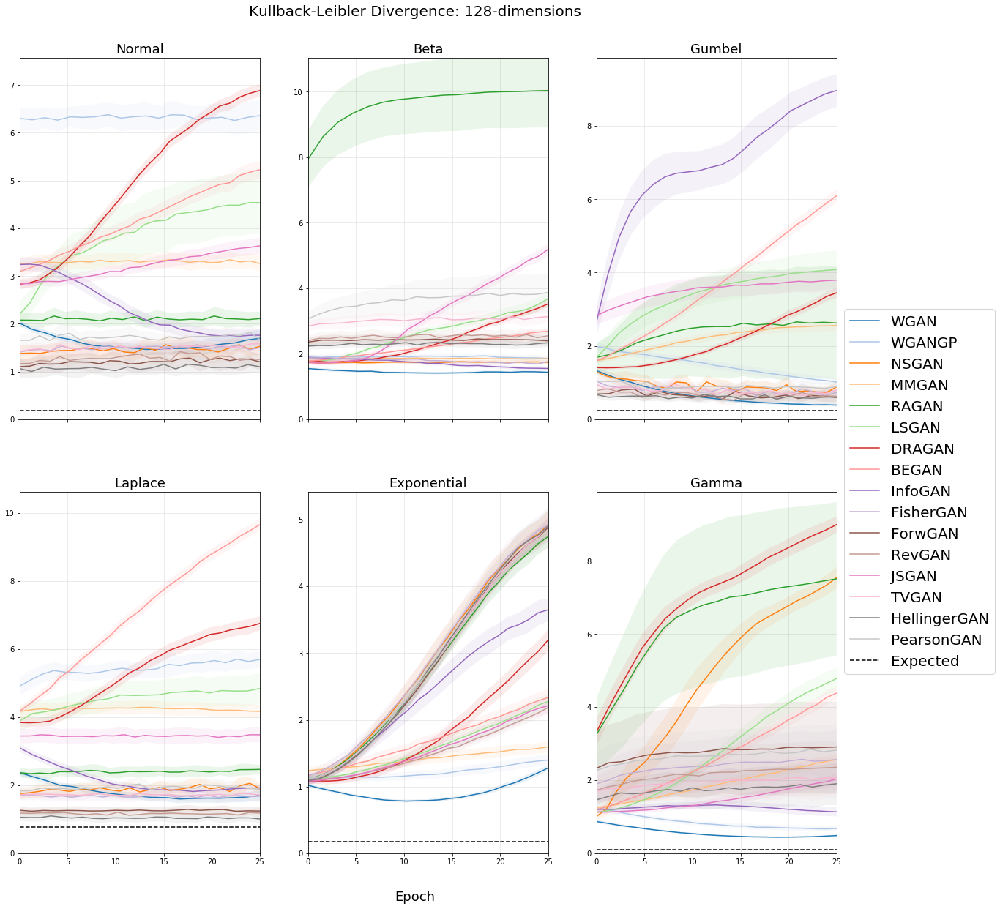

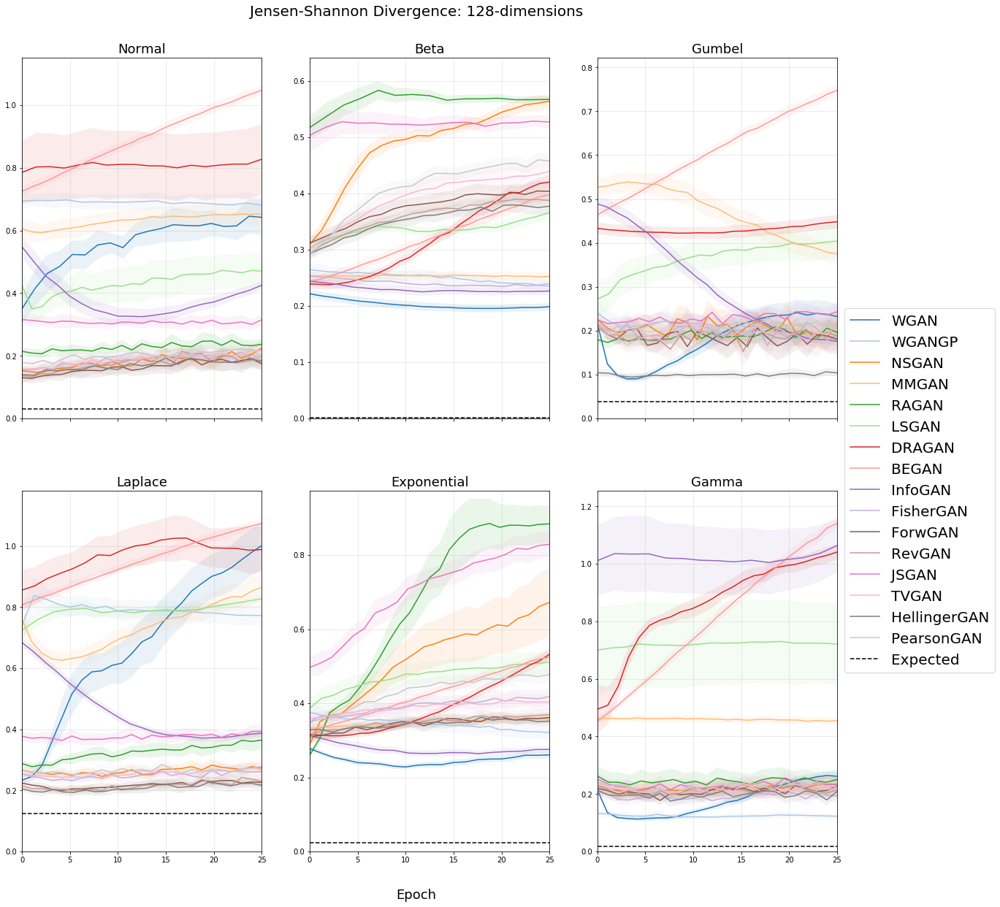

/Users/sob/github/gans6883/env/lib/python3.6/site-packages/ipykernel_launcher.py:118: RuntimeWarning: invalid value encountered in true_divide
/Users/sob/github/gans6883/env/lib/python3.6/site-packages/ipykernel_launcher.py:120: RuntimeWarning: invalid value encountered in greater


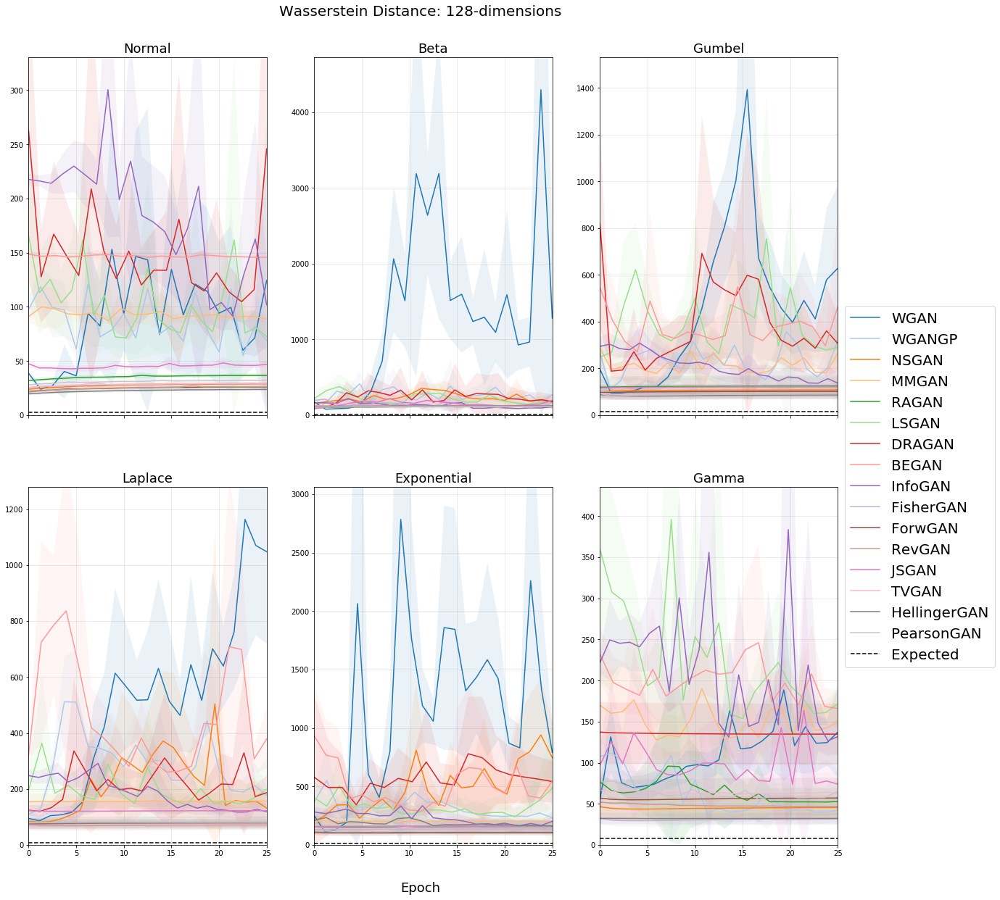

In [63]:
print(""" Plot mean performance across epochs for 1k samples""")
graph_multivariate(optimal_1000, ci=True, omit_outliers=True, thresh=2.5, save=True, dims=128, samples=1000)

 Plot mean performance across epochs for 10k samples


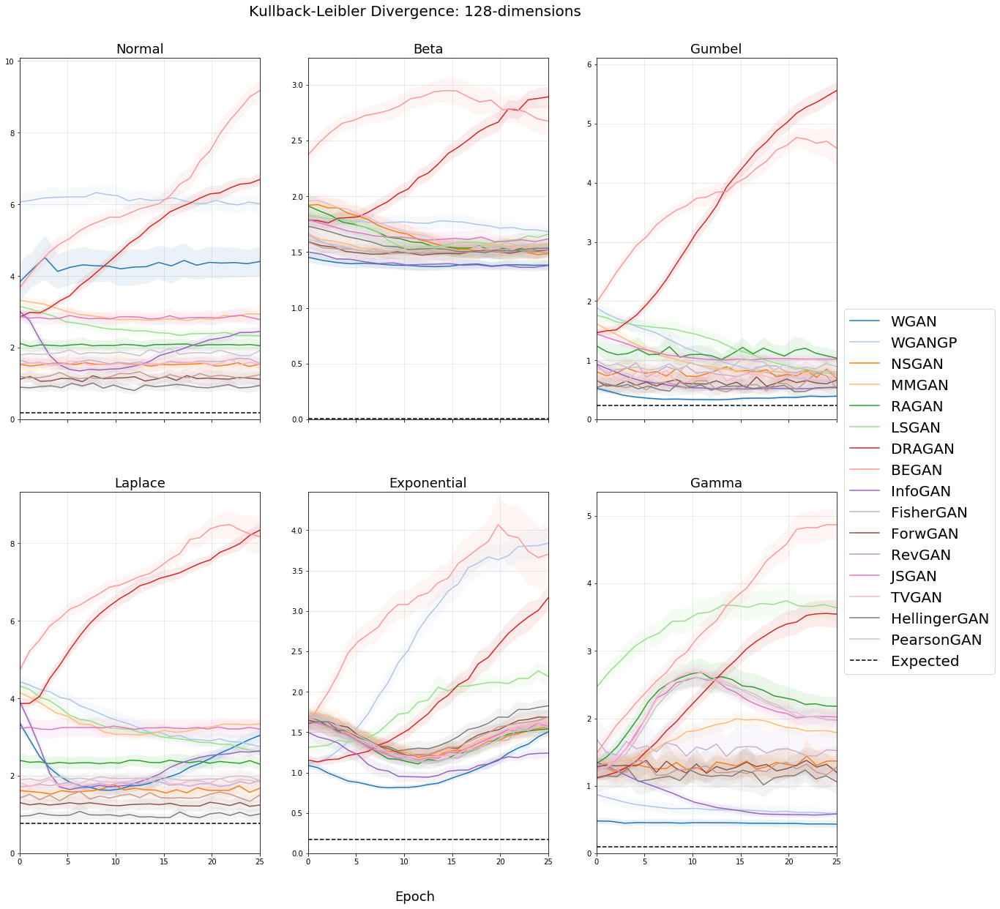

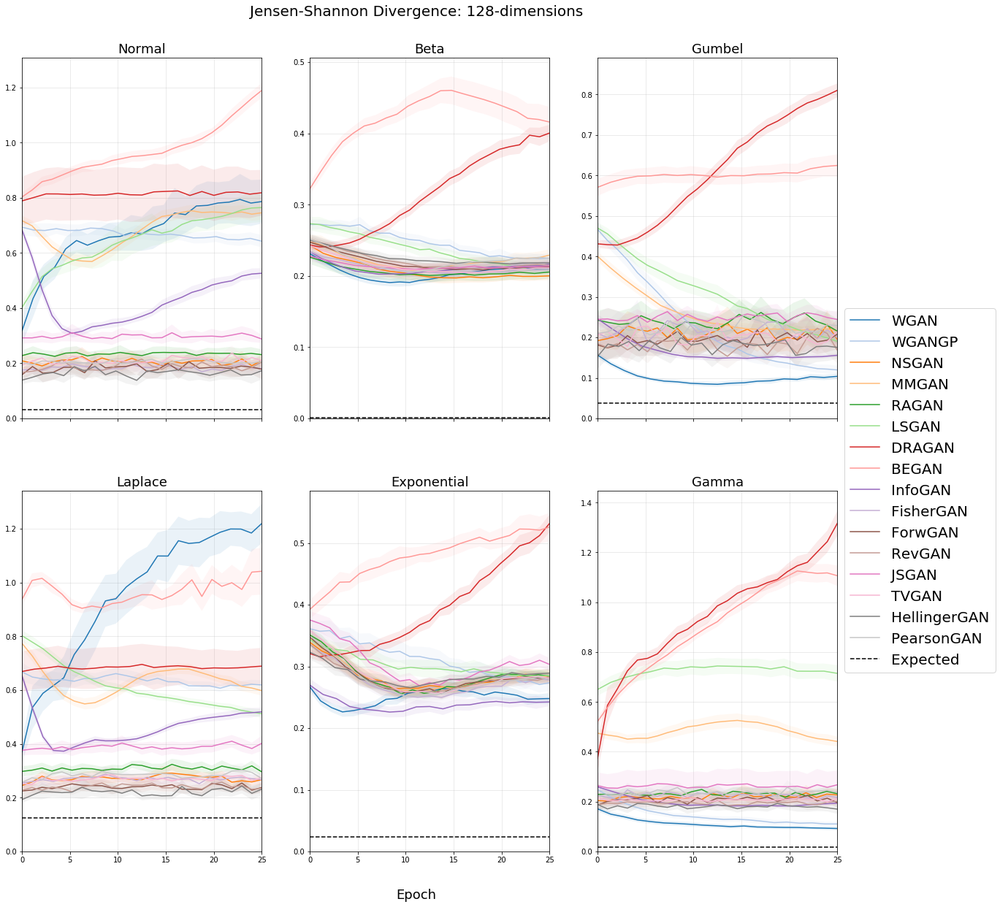

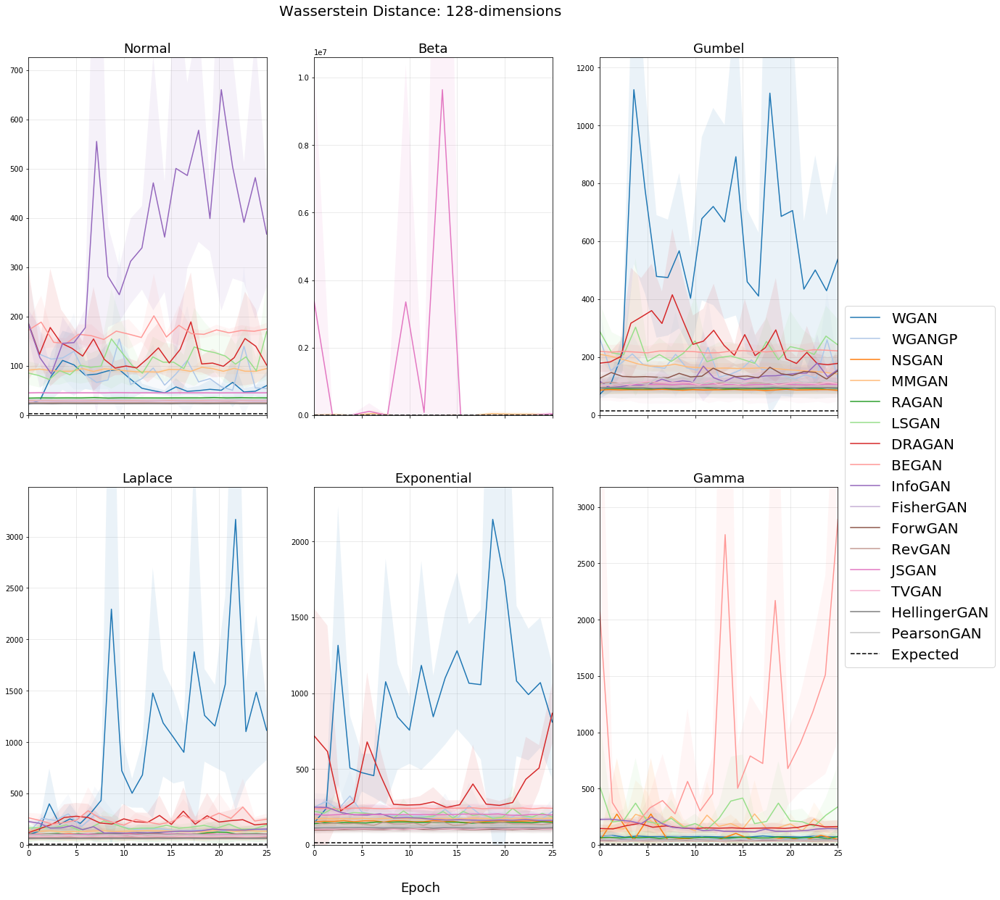

In [64]:
print(""" Plot mean performance across epochs for 10k samples""")
graph_multivariate(optimal_10000, ci=True, omit_outliers=True, thresh=3.0, save=True, dims=128, samples=10000)

 Plot mean performance across epochs for 100k samples


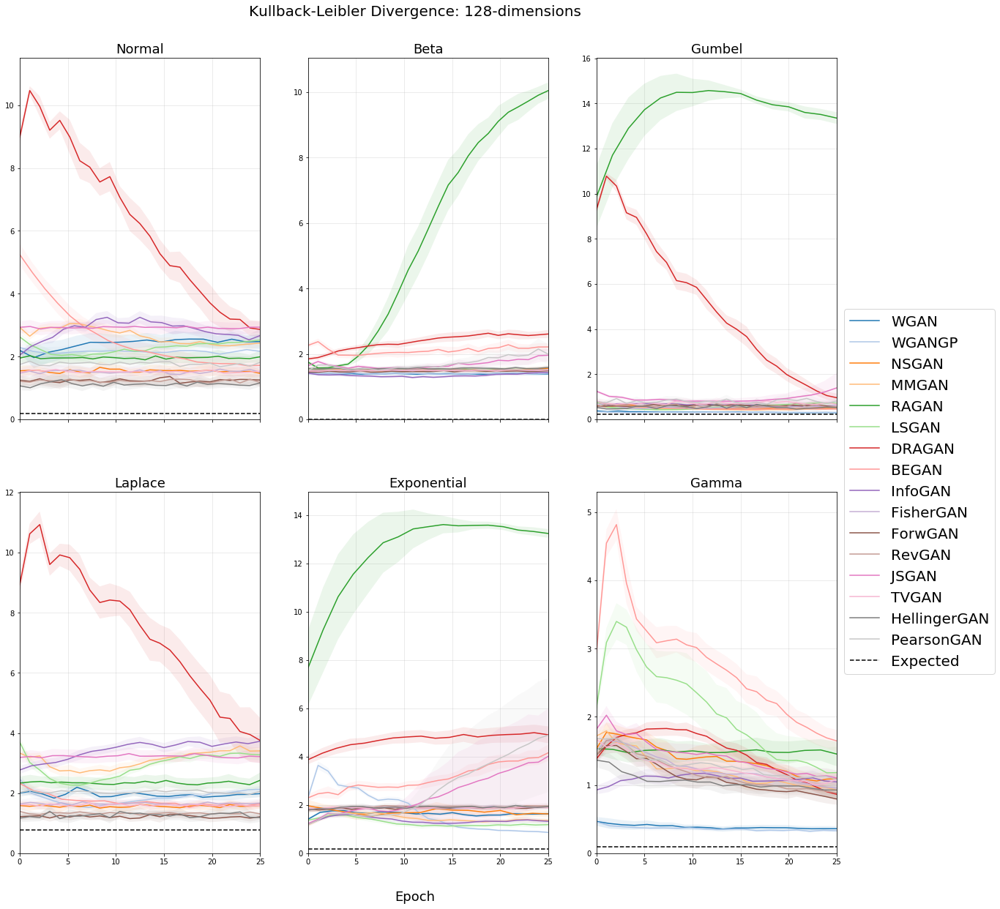

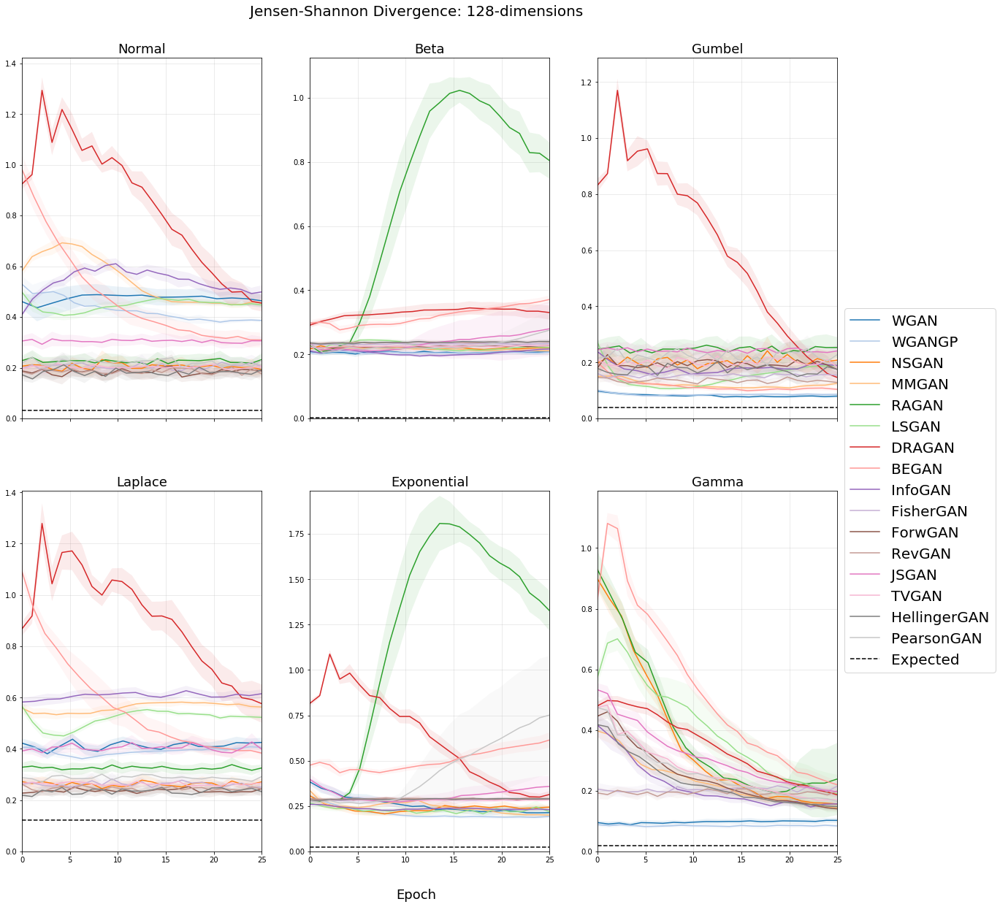

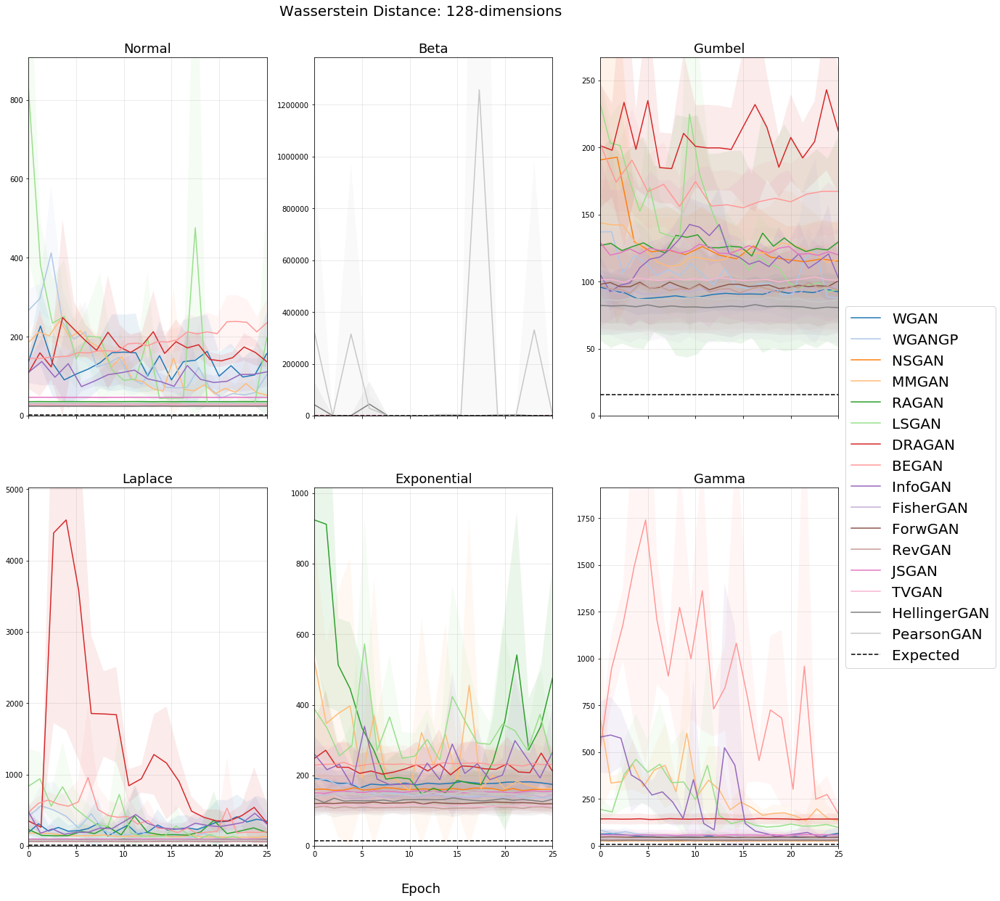

In [65]:
print(""" Plot mean performance across epochs for 100k samples""")
graph_multivariate(optimal_100000, ci=True, omit_outliers=True, thresh=3.0, save=True, dims=128, samples=100000)

In [39]:
# print(""" Print confidence intervals for minimum across all runs """)
rankings_dict = nested_pickle_dict()
param_dict = nested_pickle_dict()

for metric in distance_metrics:
    
#     print('\n======================')
#     print('{0}'.format(metric))
#     print('======================\n')
        
    for samples, optimal in [(1000, optimal_1000), (10000, optimal_10000), (100000, optimal_100000)]:
        
#         print('\n{0} Samples \n'.format(samples))

        for distribution in distributions:

            for model_name in model_names:
                
                minimums = np.nanmin(np.array(optimal[model_name][distribution][metric]['values']), axis=1)
                mu, h, low, high = mean_confidence_interval(minimums)
                param_dict[metric][model_name][distribution][samples] = '%.3f ± %.3f' % (np.round(mu, 3), np.round(h, 3))
        
        data = [[key, param_dict[metric][key]['normal'][samples], param_dict[metric][key]['beta'][samples], 
                      param_dict[metric][key]['gumbel'][samples], param_dict[metric][key]['laplace'][samples], 
                      param_dict[metric][key]['exponential'][samples], param_dict[metric][key]['gamma'][samples]]
                 for key in model_names]
#         print(tabulate(data, headers=['Model', 'Normal', 'Beta', 'Gumbel', 'Laplace', 'Exponential', 'Gamma'], tablefmt='fancy_grid'), '\n')
        
        rankings = np.argsort([[eval(i[:4]) if i[:4] != 'nan ' else 1e10 for i in j[1:]] for j in data], axis=0)
        
        for j in range(rankings.shape[1]):
            for idx, name in enumerate(rankings[:, j]):
                if model_names[name] not in rankings_dict[metric][distributions[j]]:
                    rankings_dict[metric][distributions[j]][model_names[name]] = []
                rankings_dict[metric][distributions[j]][model_names[name]].append(idx)
                
print(""" Print confidence intervals for minimum across all runs """)

for metric in distance_metrics:
    
    print('\n======================')
    print('{0}'.format(metric))
    print('======================\n')
                
    for distribution in distributions:
        
        for model_name in model_names:
            
            param_dict[metric][model_name][distribution]['performance'] = ''
        
            for samples, optimal in [(1000, optimal_1000), (10000, optimal_10000), (100000, optimal_100000)]:
                        
                minimums = np.nanmin(np.array(optimal[model_name][distribution][metric]['values']), axis=1)
                mu, h, low, high = mean_confidence_interval(minimums)
                param_dict[metric][model_name][distribution]['performance'] += '%.3f $\pm$ %.3f\n' % (np.round(mu, 3), np.round(h, 3))
        
    data = [[key, param_dict[metric][key]['normal']['performance'], param_dict[metric][key]['beta']['performance'], 
                  param_dict[metric][key]['gumbel']['performance'], param_dict[metric][key]['laplace']['performance'], 
                  param_dict[metric][key]['exponential']['performance'], param_dict[metric][key]['gamma']['performance']]
             for key in model_names]
    
    print(tabulate(data, headers=['Model', 'Normal', 'Beta', 'Gumbel', 'Laplace', 'Exponential', 'Gamma'], tablefmt='fancy_grid'), '\n')

 Print confidence intervals for minimum across all runs 

Jensen-Shannon

╒═════════════════════╤═══════════════════╤═══════════════════╤═══════════════════╤═══════════════════╤═══════════════════╤═══════════════════╕
│ Model               │ Normal            │ Beta              │ Gumbel            │ Laplace           │ Exponential       │ Gamma             │
╞═════════════════════╪═══════════════════╪═══════════════════╪═══════════════════╪═══════════════════╪═══════════════════╪═══════════════════╡
│ wgan                │ 0.157 $\pm$ 0.017 │ 0.194 $\pm$ 0.007 │ 0.085 $\pm$ 0.006 │ 0.229 $\pm$ 0.013 │ 0.222 $\pm$ 0.007 │ 0.106 $\pm$ 0.007 │
│                     │ 0.152 $\pm$ 0.014 │ 0.188 $\pm$ 0.005 │ 0.079 $\pm$ 0.005 │ 0.251 $\pm$ 0.017 │ 0.216 $\pm$ 0.006 │ 0.086 $\pm$ 0.006 │
│                     │ 0.341 $\pm$ 0.034 │ 0.192 $\pm$ 0.006 │ 0.068 $\pm$ 0.003 │ 0.349 $\pm$ 0.016 │ 0.192 $\pm$ 0.017 │ 0.081 $\pm$ 0.006 │
├─────────────────────┼───────────────────┼───────────────────

╒═════════════════════╤═══════════════════╤═══════════════════╤═══════════════════╤═══════════════════╤═══════════════════╤═══════════════════╕
│ Model               │ Normal            │ Beta              │ Gumbel            │ Laplace           │ Exponential       │ Gamma             │
╞═════════════════════╪═══════════════════╪═══════════════════╪═══════════════════╪═══════════════════╪═══════════════════╪═══════════════════╡
│ wgan                │ 1.398 $\pm$ 0.110 │ 1.370 $\pm$ 0.034 │ 0.380 $\pm$ 0.039 │ 1.545 $\pm$ 0.114 │ 0.774 $\pm$ 0.021 │ 0.432 $\pm$ 0.019 │
│                     │ 1.368 $\pm$ 0.155 │ 1.324 $\pm$ 0.037 │ 0.309 $\pm$ 0.024 │ 1.566 $\pm$ 0.124 │ 0.780 $\pm$ 0.020 │ 0.387 $\pm$ 0.047 │
│                     │ 1.501 $\pm$ 0.183 │ 1.314 $\pm$ 0.047 │ 0.268 $\pm$ 0.012 │ 1.585 $\pm$ 0.113 │ 0.816 $\pm$ 0.035 │ 0.330 $\pm$ 0.032 │
├─────────────────────┼───────────────────┼───────────────────┼───────────────────┼───────────────────┼───────────────────┼─────────────

In [40]:
print(""" Get relative ranking performance based on mean minimum performance\n """)
distance_metrics=["Jensen-Shannon", "KL-Divergence", "Wasserstein-Distance"]

print('0 is the best performance.\n1st entry: 1k samples, 2nd: 10k, 3rd: 100k \n')
for metric in distance_metrics:
    print('========{0}=======\n'.format(metric))
    
    print(tabulate([[plot_names[idx], rankings_dict[metric]['normal'][key], rankings_dict[metric]['beta'][key], rankings_dict[metric]['gumbel'][key],
                          rankings_dict[metric]['laplace'][key], rankings_dict[metric]['exponential'][key], rankings_dict[metric]['gamma'][key]] 
                    for idx, key in enumerate(model_names)], 
                   headers=['Model', 'Normal', 'Beta', 'Gumbel', 'Laplace', 'Exponential', 'Gamma'], tablefmt='latex'), '\n')

 Get relative ranking performance based on mean minimum performance
 
0 is the best performance.
1st entry: 1k samples, 2nd: 10k, 3rd: 100k 

========Jensen-Shannon=======

\begin{tabular}{lllllll}
\hline
 Model        & Normal       & Beta         & Gumbel       & Laplace      & Exponential   & Gamma        \\
\hline
 WGAN         & [6, 5, 11]   & [0, 0, 0]    & [1, 0, 0]    & [5, 7, 8]    & [0, 0, 4]     & [0, 0, 1]    \\
 WGANGP       & [9, 10, 12]  & [9, 12, 1]   & [9, 7, 1]    & [11, 11, 10] & [13, 12, 1]   & [1, 1, 0]    \\
 NSGAN        & [3, 6, 3]    & [1, 1, 4]    & [5, 3, 6]    & [6, 3, 3]    & [1, 4, 2]     & [6, 5, 6]    \\
 MMGAN        & [14, 13, 15] & [14, 5, 5]   & [13, 13, 7]  & [14, 14, 14] & [15, 5, 3]    & [14, 13, 2]  \\
 RAGAN        & [8, 8, 7]    & [2, 2, 6]    & [8, 9, 12]   & [8, 8, 7]    & [9, 6, 11]    & [10, 9, 8]   \\
 LSGAN        & [12, 12, 13] & [10, 6, 7]   & [12, 11, 8]  & [12, 12, 13] & [10, 13, 0]   & [13, 14, 12] \\
 DRAGAN       & [13, 14, 14] & [

In [41]:
print(""" Plot mean minimum performance with error bars as a function of number samples """)

for metric in distance_metrics:
    
    fig, axes = plt.subplots(2, 3, sharex=True, sharey=False, figsize=(15,15))
                
    for d_idx, distribution in enumerate(distributions):
        
        
        for idx, model_name in enumerate(model_names):

            x, y, yerr = [], [], []
            for key, val in param_dict[metric][model_name][distribution].items():
                if key == 'performance':
                    continue

                mu, err = val.split('±')
                x.append(float(key)), y.append(float(mu)), yerr.append(float(err))

            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].errorbar(x, y, xerr=0, yerr=yerr,
                                                                  barsabove=True, label=plot_names[idx],
                                                                  c=palette[idx], ecolor=palette[idx])
            axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].set_title("{0}".format(distribution.capitalize()))
            
        axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].grid(alpha=0.5)
        axes[plt_idx[d_idx][0], plt_idx[d_idx][1]].plot(x, [all_results2[distribution][metric]]*len(x), 
                                                                'k--', 
                                                                label=plot_names[-1])

    plt.xscale('log')
    fig.suptitle("{0}".format(metric), x=0.5, y=0.93, fontsize=18)
    fig.text(0.5, 0.07, "Number samples", ha='center', fontsize=15)
    plt.legend(loc='center left', bbox_to_anchor=(1, 1), fontsize=15)
    plt.savefig('../graphs/multivariate/samplesfnc_{0}_{1}_.png'.format(metric, 128), dpi=100)
    plt.show()

 Plot mean minimum performance with error bars as a function of number samples 


/Users/sob/github/gans6883/env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


In [27]:
print(""" Get number hyperparameter settings """)
print('1st entry: 1k samples, 2nd: 10k, 3rd: 100k')
print('Format: learning rate, hidden dim, bsize')


for metric in distance_metrics:
    
    print('\n======================')
    print('{0}'.format(metric))
    print('======================\n')
                
    for distribution in distributions:
        
        for model_name in model_names:
                    
            for samples, optimal in [(1000, optimal_1000), (10000, optimal_10000), (100000, optimal_100000)]:
                
                if 'params' not in param_dict[model_name][distribution][metric]:
                    param_dict[model_name][distribution][metric]['params'] = ''
                
                param_dict[model_name][distribution][metric]['params'] += ('_'.join([str(i) for i in optimal[model_name][distribution][metric]['parameters']]) + '\n')
        
    print(tabulate([[key, param_dict[key]['normal'][metric]['params'], param_dict[key]['beta'][metric]['params'], param_dict[key]['gumbel'][metric]['params'],
                          param_dict[key]['laplace'][metric]['params'], param_dict[key]['exponential'][metric]['params'], param_dict[key]['gamma'][metric]['params']]
                     for key in model_names],
                    headers=['Model', 'Normal', 'Beta', 'Gumbel', 'Laplace', 'Exponential', 'Gamma'], tablefmt='fancy_grid'))

 Get number hyperparameter settings 
1st entry: 1k samples, 2nd: 10k, 3rd: 100k
Format: learning rate, hidden dim, bsize

Jensen-Shannon

╒═════════════════════╤══════════════════╤══════════════════╤══════════════════╤══════════════════╤══════════════════╤══════════════════╕
│ Model               │ Normal           │ Beta             │ Gumbel           │ Laplace          │ Exponential      │ Gamma            │
╞═════════════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╡
│ wgan                │ 0.025_256_1024   │ 0.00025_512_1024 │ 0.025_32_1024    │ 0.025_512_1024   │ 0.0025_64_1024   │ 0.025_32_1024    │
│                     │ 0.025_256_1024   │ 0.00025_256_1024 │ 0.0025_32_1024   │ 0.025_512_1024   │ 0.00025_64_1024  │ 0.0025_32_1024   │
│                     │ 0.00025_512_1024 │ 0.00025_512_1024 │ 0.00025_32_1024  │ 0.00025_256_1024 │ 0.0025_128_1024  │ 0.0025_32_1024   │
├─────────────────────┼───────────